Link to working dataset

https://www.kaggle.com/datasets/nicholasjhana/energy-consumption-generation-prices-and-weather

Forecasting energy usage from weather data

Four years of energy and weather data are provided in 2 csv files that need to be imported. The columns of the files are list in the analysis below, productions is in mega watts MW and prices is in Euros. The weather data contains hourly observations from five cities around Spain.

The idea is to use the information provided to answer some questions, essentially to see if it is possible to forecast the daily load forecast better than what is currently done.

In [1]:
# import packages

import seaborn as sns
from sklearn.metrics import mean_squared_error
from math import sqrt
from posixpath import join
import pandas as pd
from pandas.core import describe
import matplotlib.pyplot as plt
import numpy as np
import sys
import pandas as pd
import numpy as np
import math

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn import datasets, linear_model
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor

from sklearn.metrics import accuracy_score, recall_score, precision_score, classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier

from sklearn.model_selection import train_test_split
from sklearn import linear_model
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
import operator
from sklearn.preprocessing import PolynomialFeatures

from sklearn.decomposition import PCA as sklearnPCA
from scipy.stats import pearsonr, spearmanr
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import chi2

In [2]:
!{sys.executable} -m pip install -U pandas-profiling
!jupyter nbextension enable --py widgetsnbextension
!pip install matplotlib
!pip install graphviz
!pip install sktime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 353.0/353.0 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 5.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 20.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27079 sha256=10c9457d2288b55b89b6f1687da5341b27abc54cf156f4b2b888be5a977f8424
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: wordcloud
    Found existing installation: wordcloud 1.8.2.2
    Uninstalling wordc

In [3]:
# sktime libraries for time series forecasting

from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.performance_metrics.forecasting import mean_absolute_percentage_error
from sktime.utils.plotting import plot_series

# for imputing missing na values
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

In [4]:
# set up a scaler
from sklearn.preprocessing import MinMaxScaler

In [5]:
# to get the plots to show in the same size
%matplotlib inline
plt.rcParams['figure.figsize'] = (25, 10)


Import the energy dataset and weather datasets. As with the energy dataframe need to set the time to UTC to remove the issues that arise with the move into/out of daylight savings - as it is based on Madrid timezone it is only 1 hour difference to UTC.

In [6]:
from google.colab import files
uploaded = files.upload()


Saving energy_dataset.csv to energy_dataset.csv


In [7]:
df1 = pd.read_csv('energy_dataset.csv',parse_dates=['time'],index_col=['time'])


In [8]:
uploaded = files.upload()

Saving weather_features.csv to weather_features.csv


In [9]:
df2 = pd.read_csv('weather_features.csv',parse_dates=['dt_iso'],index_col=['dt_iso'])

The data is in the Europe/Mardid timezone which has daylight savings. This in turn makes for repeated index values at the end of each daylight savings season. To avoid this the time field needs to be converted to remove this, using UTC format will do this and allow to set the index as datetime. There is only 1 hour timezone difference so insignifcant for analysis purposes. Also remove the first value which after conversion becomes the last hour in 2014 - hence select all values form 2015 or greater.

In [10]:
# set the index as datetime type and set to UTC time - then set to correct timezone Europe/Madrid
df1.index = pd.to_datetime(df1.index, utc='True')
#df1.index = df1.index.tz_convert('Europe/Madrid')  -- can't be done or repeated values occur
# check datatype - now is a datetime
df1.index

DatetimeIndex(['2014-12-31 23:00:00+00:00', '2015-01-01 00:00:00+00:00',
               '2015-01-01 01:00:00+00:00', '2015-01-01 02:00:00+00:00',
               '2015-01-01 03:00:00+00:00', '2015-01-01 04:00:00+00:00',
               '2015-01-01 05:00:00+00:00', '2015-01-01 06:00:00+00:00',
               '2015-01-01 07:00:00+00:00', '2015-01-01 08:00:00+00:00',
               ...
               '2018-12-31 13:00:00+00:00', '2018-12-31 14:00:00+00:00',
               '2018-12-31 15:00:00+00:00', '2018-12-31 16:00:00+00:00',
               '2018-12-31 17:00:00+00:00', '2018-12-31 18:00:00+00:00',
               '2018-12-31 19:00:00+00:00', '2018-12-31 20:00:00+00:00',
               '2018-12-31 21:00:00+00:00', '2018-12-31 22:00:00+00:00'],
              dtype='datetime64[ns, UTC]', name='time', length=35064, freq=None)

In [11]:
# use tz_localize to remove the timezone but keep the time the same
df1 = df1.tz_localize(None)
# remove the 2014 value
df1 = df1[df1.index.year >=2015]
df1.index

DatetimeIndex(['2015-01-01 00:00:00', '2015-01-01 01:00:00',
               '2015-01-01 02:00:00', '2015-01-01 03:00:00',
               '2015-01-01 04:00:00', '2015-01-01 05:00:00',
               '2015-01-01 06:00:00', '2015-01-01 07:00:00',
               '2015-01-01 08:00:00', '2015-01-01 09:00:00',
               ...
               '2018-12-31 13:00:00', '2018-12-31 14:00:00',
               '2018-12-31 15:00:00', '2018-12-31 16:00:00',
               '2018-12-31 17:00:00', '2018-12-31 18:00:00',
               '2018-12-31 19:00:00', '2018-12-31 20:00:00',
               '2018-12-31 21:00:00', '2018-12-31 22:00:00'],
              dtype='datetime64[ns]', name='time', length=35063, freq=None)

In [12]:
# explore the column names
df1.columns

Index(['generation biomass', 'generation fossil brown coal/lignite',
       'generation fossil coal-derived gas', 'generation fossil gas',
       'generation fossil hard coal', 'generation fossil oil',
       'generation fossil oil shale', 'generation fossil peat',
       'generation geothermal', 'generation hydro pumped storage aggregated',
       'generation hydro pumped storage consumption',
       'generation hydro run-of-river and poundage',
       'generation hydro water reservoir', 'generation marine',
       'generation nuclear', 'generation other', 'generation other renewable',
       'generation solar', 'generation waste', 'generation wind offshore',
       'generation wind onshore', 'forecast solar day ahead',
       'forecast wind offshore eday ahead', 'forecast wind onshore day ahead',
       'total load forecast', 'total load actual', 'price day ahead',
       'price actual'],
      dtype='object')

In [13]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 35063 entries, 2015-01-01 00:00:00 to 2018-12-31 22:00:00
Data columns (total 28 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   generation biomass                           35044 non-null  float64
 1   generation fossil brown coal/lignite         35045 non-null  float64
 2   generation fossil coal-derived gas           35045 non-null  float64
 3   generation fossil gas                        35045 non-null  float64
 4   generation fossil hard coal                  35045 non-null  float64
 5   generation fossil oil                        35044 non-null  float64
 6   generation fossil oil shale                  35045 non-null  float64
 7   generation fossil peat                       35045 non-null  float64
 8   generation geothermal                        35045 non-null  float64
 9   generation hydro pumped storage aggre

In [14]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 178396 entries, 2015-01-01 00:00:00+01:00 to 2018-12-31 23:00:00+01:00
Data columns (total 16 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   city_name            178396 non-null  object 
 1   temp                 178396 non-null  float64
 2   temp_min             178396 non-null  float64
 3   temp_max             178396 non-null  float64
 4   pressure             178396 non-null  int64  
 5   humidity             178396 non-null  int64  
 6   wind_speed           178396 non-null  int64  
 7   wind_deg             178396 non-null  int64  
 8   rain_1h              178396 non-null  float64
 9   rain_3h              178396 non-null  float64
 10  snow_3h              178396 non-null  float64
 11  clouds_all           178396 non-null  int64  
 12  weather_id           178396 non-null  int64  
 13  weather_main         178396 non-null  object 
 14  weather_description  178396 no

In [15]:
df1.head()

,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,NaN,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2015-01-01 01:00:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,NaN,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
2015-01-01 02:00:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,NaN,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
2015-01-01 03:00:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,NaN,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04
2015-01-01 04:00:00,410.0,178.0,0.0,4038.0,3590.0,156.0,0.0,0.0,0.0,NaN,...,188.0,0.0,4618.0,4.0,NaN,4617.0,21441.0,19905.0,35.72,53.63


In [16]:
df2.head()

,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
dt_iso,,,,,,,,,,,,,,,,
2015-01-01 00:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2015-01-01 01:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2015-01-01 02:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2015-01-01 03:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2015-01-01 04:00:00+01:00,Valencia,269.686,269.686,269.686,1002,78,0,23,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [ ]:
# 820 project:Predicting energy demand in Spain (four year of hourly unit electric consumption, generation, pricing, and weather data in SPain(5 cities))
# Use panda_profiling library to investigate the data
from pandas_profiling import ProfileReport
profile1 = ProfileReport(df1)
profile1.to_notebook_iframe()

<ipython-input-17-c144c1413960>:3: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Now to clean up the datset based on the report above. Several columns can be dropped as they contain no data or are all zero. No other columns have more than 0.1% of data missing so no need to perform any further cleaning/dropping/imputation - from pandas_profile

Empty columns are: generation fossil coal-derived gas, generation fossil oil shale, generation fossil peat, generation geothermal, generation hydro pumped storage aggregated, generation marine, generation wind offshore, forecast wind offshore eday ahead ( My choosen dependent variable for classification which is not correct).


In [17]:
# drop columns
df1 = df1.drop(columns=['generation fossil coal-derived gas', 'generation fossil oil shale', 'generation fossil peat', 'generation geothermal',
                        'generation hydro pumped storage aggregated', 'generation marine', 'generation wind offshore', 'forecast wind offshore eday ahead'],axis=1)

In [18]:
# checking columns wered dropped - yes 8 columns dropped
df1.shape

(35063, 20)

In [19]:
# check for any duplicates - none so no need to drop any duplicates
df1.index.has_duplicates

False

Check for na values, and if there are any use a Iterative imputer from scikit learn to replace (it is a better estimator than using the mean or median like the SimpleImputer)

In [20]:
df1.isna().sum()

generation biomass                             19
generation fossil brown coal/lignite           18
generation fossil gas                          18
generation fossil hard coal                    18
generation fossil oil                          19
generation hydro pumped storage consumption    19
generation hydro run-of-river and poundage     19
generation hydro water reservoir               18
generation nuclear                             17
generation other                               18
generation other renewable                     18
generation solar                               18
generation waste                               19
generation wind onshore                        18
forecast solar day ahead                        0
forecast wind onshore day ahead                 0
total load forecast                             0
total load actual                              36
price day ahead                                 0
price actual                                    0


In [21]:
# now to useIterative imputer
imputer = IterativeImputer(max_iter=10, random_state=0)
imputer.fit(df1)
df1_filled = pd.DataFrame(imputer.transform(df1), columns = df1.columns, index=df1.index)

/usr/local/lib/python3.10/dist-packages/sklearn/impute/_iterative.py:785: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


In [22]:
df1_filled.index

DatetimeIndex(['2015-01-01 00:00:00', '2015-01-01 01:00:00',
               '2015-01-01 02:00:00', '2015-01-01 03:00:00',
               '2015-01-01 04:00:00', '2015-01-01 05:00:00',
               '2015-01-01 06:00:00', '2015-01-01 07:00:00',
               '2015-01-01 08:00:00', '2015-01-01 09:00:00',
               ...
               '2018-12-31 13:00:00', '2018-12-31 14:00:00',
               '2018-12-31 15:00:00', '2018-12-31 16:00:00',
               '2018-12-31 17:00:00', '2018-12-31 18:00:00',
               '2018-12-31 19:00:00', '2018-12-31 20:00:00',
               '2018-12-31 21:00:00', '2018-12-31 22:00:00'],
              dtype='datetime64[ns]', name='time', length=35063, freq=None)

In [23]:
# check all na values have been imputed and there are no na's in the dtaframe
df1_filled.isna().sum()

generation biomass                             0
generation fossil brown coal/lignite           0
generation fossil gas                          0
generation fossil hard coal                    0
generation fossil oil                          0
generation hydro pumped storage consumption    0
generation hydro run-of-river and poundage     0
generation hydro water reservoir               0
generation nuclear                             0
generation other                               0
generation other renewable                     0
generation solar                               0
generation waste                               0
generation wind onshore                        0
forecast solar day ahead                       0
forecast wind onshore day ahead                0
total load forecast                            0
total load actual                              0
price day ahead                                0
price actual                                   0
dtype: int64

In [24]:
# rename it back to df1
df1 = df1_filled

In [25]:
# check shape again
df1.shape

(35063, 20)

Boxplot of each column to look at the spread of data and check for outliers - no obvious outliers so read to use the df_energy dataframe.
Looks like the biggest sources of energy are fossil gas, wind onshore, nuclear, hydro reservoir and solar

<Axes: >

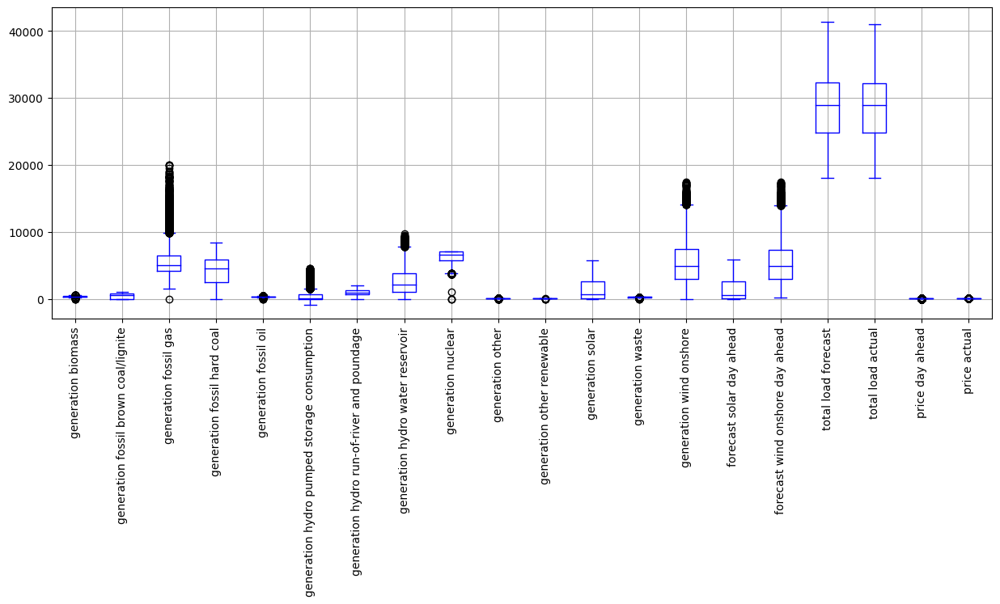

In [ ]:
# boxplots of each column with labels at 90 for eas of reading
df1.boxplot(rot='vertical', color="blue",figsize=(15,5))

Add another column to 'total generation' as sum of all the types of energy generated.

In [26]:
df1['total generation'] = df1['generation fossil gas']+df1['generation fossil hard coal']+df1['generation nuclear']+df1['generation wind onshore']+ df1['generation other']+df1['generation other renewable']+df1['generation waste']+df1['generation hydro water reservoir']+ df1['generation hydro pumped storage consumption']+df1['generation hydro run-of-river and poundage']+df1['generation solar']

Plots of Generation type versus date - visualising the generation amounts by type

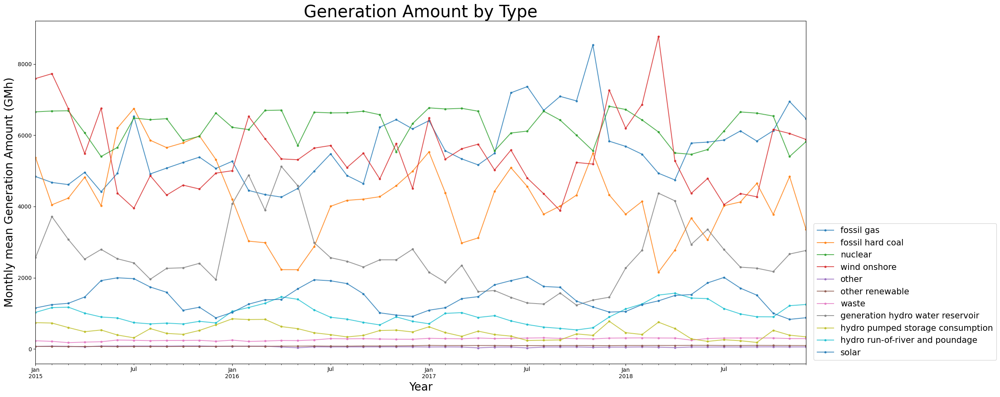

In [ ]:
#axes = df1['total generation'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='total')
axes = df1['generation fossil gas'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='fossil gas')
axes = df1['generation fossil hard coal'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='fossil hard coal')
axes = df1['generation nuclear'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='nuclear')
axes = df1['generation wind onshore'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='wind onshore')


axes = df1['generation other'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='other')
axes = df1['generation other renewable'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='other renewable')
axes = df1['generation waste'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='waste')
axes = df1['generation hydro water reservoir'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='generation hydro water reservoir')
axes = df1['generation hydro pumped storage consumption'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='hydro pumped storage consumption')
axes = df1['generation hydro run-of-river and poundage'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='hydro run-of-river and poundage')
axes = df1['generation solar'].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='solar')

axes.legend(loc='upper right', frameon=False, fontsize=15)
axes.set_title('Generation Amount by Type', fontsize=30)
axes.set_ylabel('Monthly mean Generation Amount (GMh)', fontsize=20)
axes.set_xlabel("Year", fontsize=20)
axes.legend(loc=(1.01, .01), ncol=1, fontsize=15)
plt.tight_layout()

A better way to visualise is by percentage of total energy generated by source resampled monthly (figures are provided for every hour of the day, but give too many data points to plot nicely so resampling by month is used here)

Interestingly no single source provides more than 30% of the total (only twice are figures above 25% ) and the 5 sources that provide at least more than 10% are nuclear, fossil hard coal, onshore wind, fossil gas and hydro water reservoir.

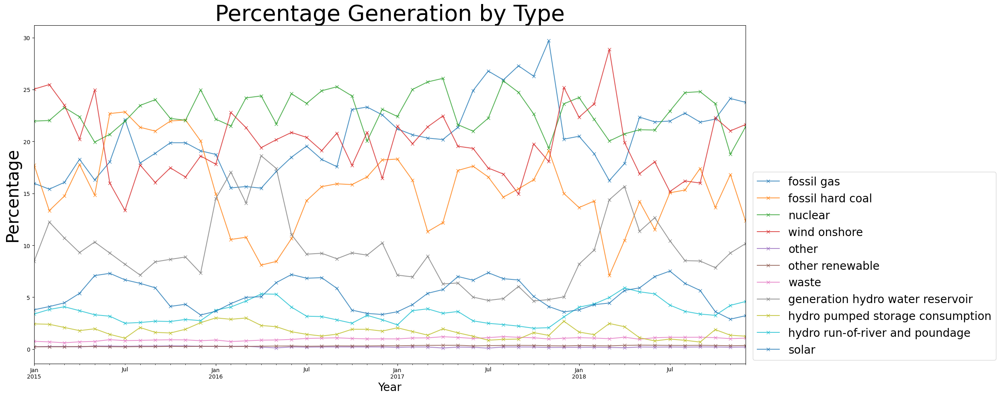

In [ ]:
axes = df1['generation fossil gas'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='fossil gas')
axes = df1['generation fossil hard coal'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='fossil hard coal')
axes = df1['generation nuclear'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='nuclear')
axes = df1['generation wind onshore'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='wind onshore')


axes = df1['generation other'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='other')
axes = df1['generation other renewable'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='other renewable')
axes = df1['generation waste'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='waste')
axes = df1['generation hydro water reservoir'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='generation hydro water reservoir')
axes = df1['generation hydro pumped storage consumption'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='hydro pumped storage consumption')
axes = df1['generation hydro run-of-river and poundage'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='hydro run-of-river and poundage')
axes = df1['generation solar'].resample("M").mean().div(df1['total generation'].resample("M").mean()).multiply(100).plot(marker='x', alpha=0.8,  figsize=(25,10), label='solar')

axes.legend(loc='upper right', frameon=False, fontsize=15)
axes.set_title('Percentage Generation by Type', fontsize=40)
axes.set_ylabel('Percentage', fontsize=30)
axes.set_xlabel("Year", fontsize=20)
axes.legend(loc=(1.01, .01), ncol=1, fontsize=20)
plt.tight_layout()

Total percentages of production averaged over the 4 year period


Some seasonality of production is evident too - solar for example peaks each July which make sense as that is summer and solar energy is stronger, the use of fossil hard coal dips each february/march (not sure why)

In [ ]:
# Calculate the percentages and print out.
print('Ordered percentage of total power generated over the 4 years by each source ')
print()
print("generation nuclear                         ",round((df1['generation nuclear'].sum()/df1['total generation'].sum())*100,1),'%')
print("generation fossil gas                      ",round((df1['generation fossil gas'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation wind onshore                    ',round((df1['generation wind onshore'].sum()/df1['total generation'].sum())*100,1),'%')
print("generation fossil hard coal                ",round((df1['generation fossil hard coal'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation hydro water reservoir            ',round((df1['generation hydro water reservoir'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation solar                            ',round((df1['generation solar'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation hydro run-of-river and poundage  ',round((df1['generation hydro run-of-river and poundage'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation hydro pumped storage consumption ',round((df1['generation hydro pumped storage consumption'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation waste                            ',round((df1['generation waste'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation other renewable                  ',round((df1['generation other renewable'].sum()/df1['total generation'].sum())*100,1),'%')
print('generation other                            ',round((df1['generation other'].sum()/df1['total generation'].sum())*100,1),'%')

Ordered percentage of total power generated over the 4 years by each source 

generation nuclear                          22.8 %
generation fossil gas                       20.4 %
generation wind onshore                     19.9 %
generation fossil hard coal                 15.5 %
generation hydro water reservoir             9.5 %
generation solar                             5.2 %
generation hydro run-of-river and poundage   3.5 %
generation hydro pumped storage consumption  1.7 %
generation waste                             1.0 %
generation other renewable                   0.3 %
generation other                             0.2 %


Below plots show day ahead price vs actual (monthly means values) - the day ahead price is always cheaper (not always but sampled monthly it is - daily the graph is too messy) - so forecasting demand a day ahead accurately could be very useful - that is the task performed later.

Text(0, 0.5, 'Cost $')

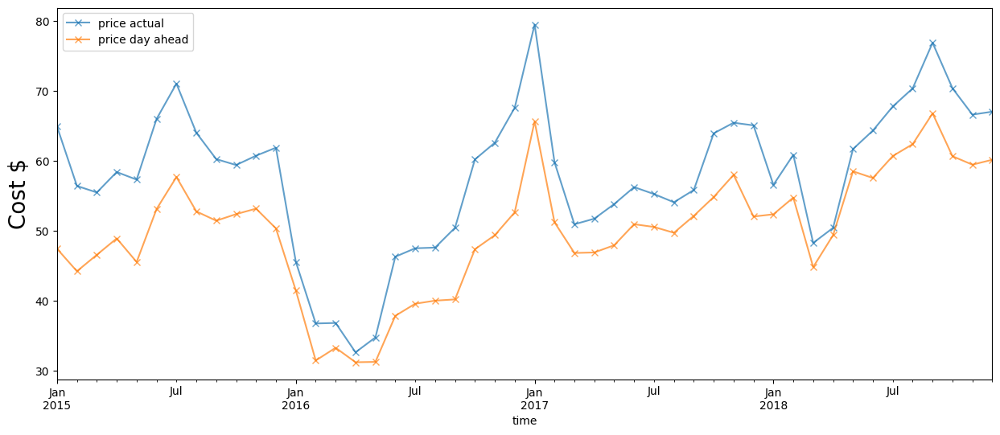

In [ ]:
total_load = ['price actual','price day ahead']

group = df1[total_load].groupby(pd.Grouper(freq='M')).mean()
axes = group.plot(kind='line',marker='x', alpha=0.7,  figsize=(15,6))
axes.set_ylabel('Cost $', fontsize=20)

In [ ]:
# price the day ahead and the actual price averaged over the year
prices = ['price day ahead','price actual' ]
df1.groupby(df1.index.year)[prices].mean()

,price day ahead,price actual
time,,
2015,50.324661,61.359949
2016,39.668449,47.438307
2017,52.233312,59.321965
2018,57.299726,63.444265


Monthly average graph of total load forecast and actual, then monthly price forecast versus actual

Averaged over a month the load forecast is very similar to the actual wich is a sign the forecasting is good on average over a month (the daily plot is too messy to include but it is needed for Q2).

Text(0, 0.5, 'Daily Totals (GWh)')

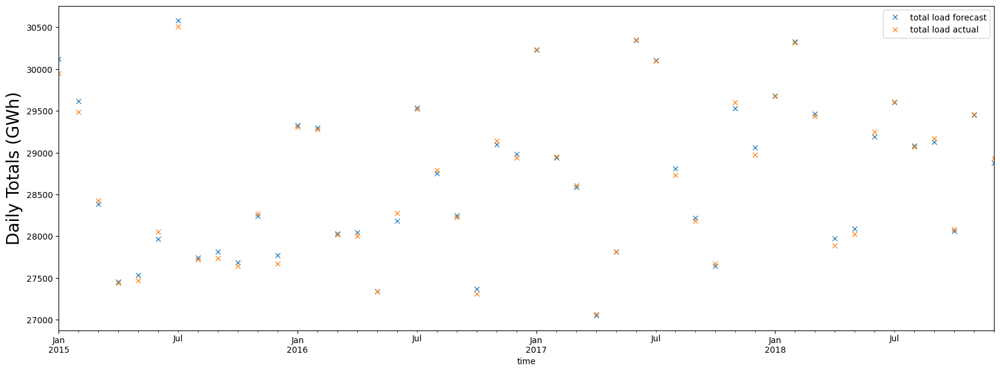

In [ ]:
# load forecast vs actual - monthly resampled
total_load = ['total load forecast','total load actual']

group = df1[total_load].groupby(pd.Grouper(freq='M')).mean()
axes = group.plot(marker='x', alpha=0.9, linestyle='None', figsize=(20,7))
axes.set_ylabel('Daily Totals (GWh)', fontsize=20)
# can do similar for 4 reg model

Text(0, 0.5, 'Daily Totals (GWh)')

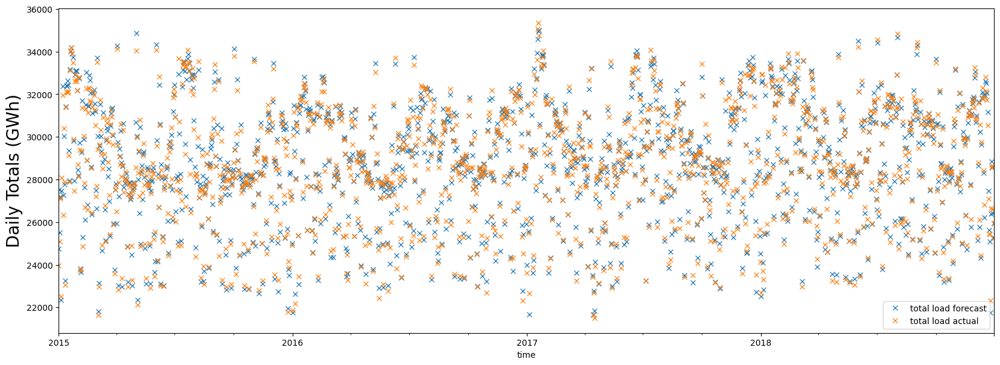

In [ ]:
# load forecast vs actual - daily resampled
total_load = ['total load forecast','total load actual']

group = df1[total_load].groupby(pd.Grouper(freq='D')).mean()
axes = group.plot(marker='x', alpha=0.9, linestyle='None', figsize=(20,7))
axes.set_ylabel('Daily Totals (GWh)', fontsize=20)

Now some exploratory data analysis with the weather dataset. Including doing the same thing with datetime index as with energy dataset. Including removing the first value which become a 2014 value)

In [27]:
# to show the parse dates hasn't worked so need to do explicitly in next step
print(df2.index.name)
print(df2.index.dtype)

dt_iso
object


In [28]:
# make sure the index is in datetime format.
df2.index = pd.to_datetime(df2.index, utc='True')
#df2.index = df2.index.tz_convert('Europe/Madrid') - can't do this or get repeat index values
df2.index

DatetimeIndex(['2014-12-31 23:00:00+00:00', '2015-01-01 00:00:00+00:00',
               '2015-01-01 01:00:00+00:00', '2015-01-01 02:00:00+00:00',
               '2015-01-01 03:00:00+00:00', '2015-01-01 04:00:00+00:00',
               '2015-01-01 05:00:00+00:00', '2015-01-01 06:00:00+00:00',
               '2015-01-01 07:00:00+00:00', '2015-01-01 08:00:00+00:00',
               ...
               '2018-12-31 13:00:00+00:00', '2018-12-31 14:00:00+00:00',
               '2018-12-31 15:00:00+00:00', '2018-12-31 16:00:00+00:00',
               '2018-12-31 17:00:00+00:00', '2018-12-31 18:00:00+00:00',
               '2018-12-31 19:00:00+00:00', '2018-12-31 20:00:00+00:00',
               '2018-12-31 21:00:00+00:00', '2018-12-31 22:00:00+00:00'],
              dtype='datetime64[ns, UTC]', name='dt_iso', length=178396, freq=None)

In [29]:
# use tz_localize to remove the timezone but keep the time the same
df2 = df2.tz_localize(None)
# remove the 1 value that becomes a 2014 value
df2 = df2[df2.index.year >=2015]
df2.index

DatetimeIndex(['2015-01-01 00:00:00', '2015-01-01 01:00:00',
               '2015-01-01 02:00:00', '2015-01-01 03:00:00',
               '2015-01-01 04:00:00', '2015-01-01 05:00:00',
               '2015-01-01 06:00:00', '2015-01-01 07:00:00',
               '2015-01-01 08:00:00', '2015-01-01 09:00:00',
               ...
               '2018-12-31 13:00:00', '2018-12-31 14:00:00',
               '2018-12-31 15:00:00', '2018-12-31 16:00:00',
               '2018-12-31 17:00:00', '2018-12-31 18:00:00',
               '2018-12-31 19:00:00', '2018-12-31 20:00:00',
               '2018-12-31 21:00:00', '2018-12-31 22:00:00'],
              dtype='datetime64[ns]', name='dt_iso', length=178391, freq=None)

In [30]:
df2.index.dtype

dtype('<M8[ns]')

Checking for na values - none

In [31]:
df2.isna().sum()

city_name              0
temp                   0
temp_min               0
temp_max               0
pressure               0
humidity               0
wind_speed             0
wind_deg               0
rain_1h                0
rain_3h                0
snow_3h                0
clouds_all             0
weather_id             0
weather_main           0
weather_description    0
weather_icon           0
dtype: int64

In [32]:
df2.columns

Index(['city_name', 'temp', 'temp_min', 'temp_max', 'pressure', 'humidity',
       'wind_speed', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_3h', 'clouds_all',
       'weather_id', 'weather_main', 'weather_description', 'weather_icon'],
      dtype='object')

Drop the Kelvin temperatures and keep the celsius instead, Also Rain_3h is redundant given rain_1h, and full weather description and icon aren't need either

In [33]:
# drop these columns - keep temperature columns in Celsius,
df2.drop(columns = [ 'rain_3h','weather_id','weather_description', 'weather_icon' ],axis=1, inplace=True)

In [34]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 178391 entries, 2015-01-01 00:00:00 to 2018-12-31 22:00:00
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   city_name     178391 non-null  object 
 1   temp          178391 non-null  float64
 2   temp_min      178391 non-null  float64
 3   temp_max      178391 non-null  float64
 4   pressure      178391 non-null  int64  
 5   humidity      178391 non-null  int64  
 6   wind_speed    178391 non-null  int64  
 7   wind_deg      178391 non-null  int64  
 8   rain_1h       178391 non-null  float64
 9   snow_3h       178391 non-null  float64
 10  clouds_all    178391 non-null  int64  
 11  weather_main  178391 non-null  object 
dtypes: float64(5), int64(5), object(2)
memory usage: 17.7+ MB


In [35]:
df2.shape

(178391, 12)

In [36]:
# check for duplicates - yes
df2.index.has_duplicates

True

In [37]:
# So need to drop any duplicates
df2 = df2.drop_duplicates(keep='first')

In [38]:
# check to shape to see if any duplicates were dropped - yes 178306-169774 = 8532 rows dropped or 5%
df2.shape

(168456, 12)

In [39]:
# rows dropped as a percentage 178306-169774 = 8532 rows dropped or 5%
((178306-169774)/169774)*100

5.025504494209949

In [ ]:

profile2 = ProfileReport(df2)
profile2.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

From the above report there is no real data missing - just need to check number of records for each city - all relatively similar ~ 35,000, so no location bias is likely

<Axes: xlabel='city_name'>

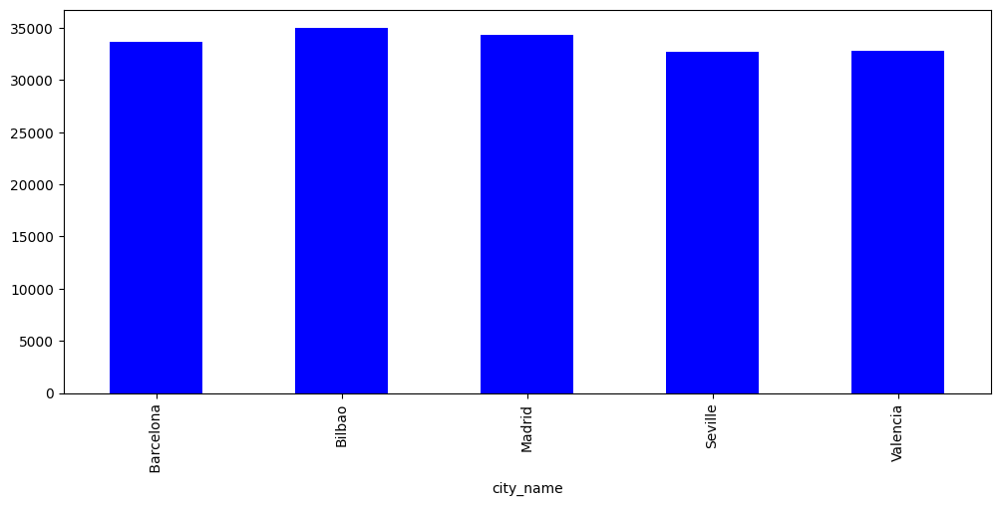

In [40]:
# As a check of number of records for each city simply check the number of temperature records and then plot.
df2.groupby(["city_name"])[['temp']].count().plot.bar(color="blue", legend=False, figsize=(12,5))

So the count of values from each site is very similar (from the above bar chart). Next check for outliers and/or incorrect values

<Axes: >

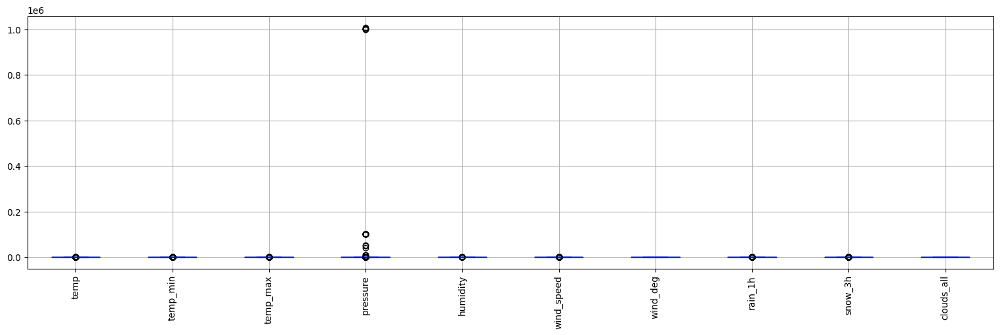

In [ ]:
# boxplots for all features with labels rotated for readability. There seems to be a problem with pressure
df2.boxplot(rot='vertical', color='blue',figsize=(19, 5))

There is definitely a problem with some pressure values. Pressure is generally measured in hectopascals hPa and actually has a tight range - definitely no less than 950 or higher that 1050. Here is a link to record values for Spanish max/min pressure - min is 950hPa, max is 1051hPa so will use these to cut off values. https://en.wikipedia.org/wiki/List_of_atmospheric_pressure_records_in_Europe#Spain

In [41]:
# from the above there seems to be a problem with pressure
df2['pressure'].describe()

count    1.684560e+05
mean     1.073121e+03
std      6.143207e+03
min      0.000000e+00
25%      1.014000e+03
50%      1.018000e+03
75%      1.022000e+03
max      1.008371e+06
Name: pressure, dtype: float64

In [42]:
# drop any duplicates
df2 = df2.drop_duplicates(keep='first')

So lets look at the spread and count of values less than 955 or greater than 1051 (1228 with bad pressure values)

In [43]:
sum(df2['pressure']<=955) + sum(df2['pressure']>=1051)

1228

In [44]:
# examining some records shows that the pressure is just wrong - see the pressure column.
df2[df2['pressure']>=1051]

,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,snow_3h,clouds_all,weather_main
dt_iso,,,,,,,,,,,,
2016-07-21 19:00:00,Valencia,298.94,298.71,299.26,1073,41,3,107,0.0,0.0,0,clear
2016-08-03 15:00:00,Valencia,308.34,302.75,312.04,1075,46,1,292,0.0,0.0,32,clouds
2016-08-03 16:00:00,Valencia,305.31,302.75,306.48,1074,45,1,315,0.0,0.0,8,clear
2016-08-03 17:00:00,Valencia,304.55,302.55,305.37,1073,47,0,180,0.0,0.0,20,clouds
2016-08-03 18:00:00,Valencia,302.94,301.65,303.71,1074,47,1,135,0.0,0.0,20,clouds
...,...,...,...,...,...,...,...,...,...,...,...,...
2015-02-22 09:00:00,Barcelona,283.86,283.86,283.86,10029,0,1,67,0.0,0.0,0,clear
2015-02-22 10:00:00,Barcelona,285.05,285.05,285.05,100304,0,6,67,0.0,0.0,0,clear
2015-02-22 11:00:00,Barcelona,285.45,285.45,285.45,100242,0,7,337,0.0,0.0,0,clear


Based on the fact there are 169774 rows of data I will simply remove the rows with pressure errors rather than try to correct as they are ony 1309 rows out of 169774 total or 0.01% of the total.

In [45]:
# remove pressure values less than 955 and greater than 1055
df2 = df2[df2['pressure']>= 955]
df2 = df2[df2['pressure']<= 1051]

In [46]:
# rows with bad pressure data removed
df2.shape

(167295, 12)

<Axes: >

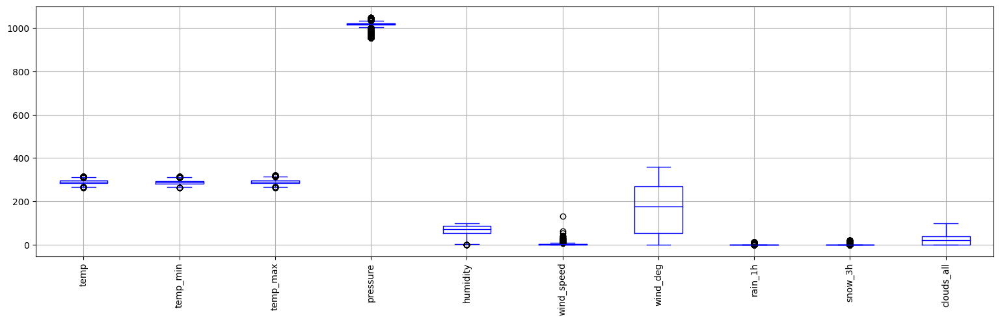

In [47]:
# boxplots for all features with labels rotated for readability.Pressue values fixed - but now wind_speed seems to have a large value
df2.boxplot(rot='vertical', color="blue",figsize=(19, 5))


<Axes: >

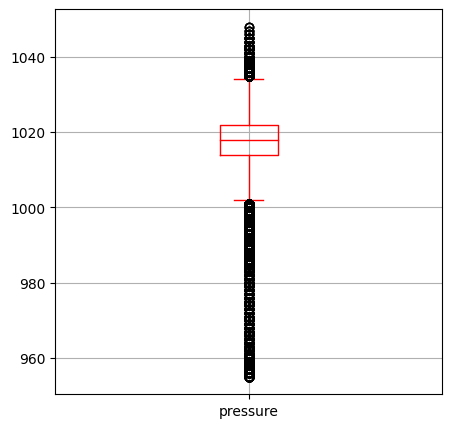

In [48]:
df2 = df2[df2['pressure']<=1051]
df2.boxplot(column='pressure', color="red",figsize=(5, 5))

<Axes: >

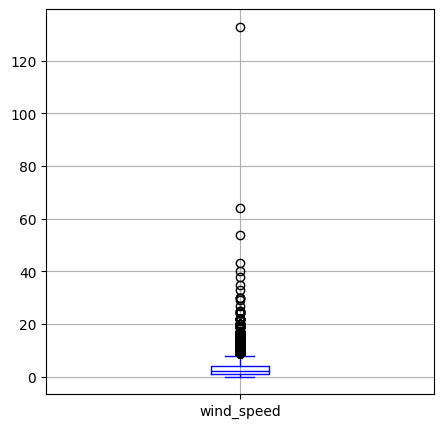

In [49]:
# checking the wind speed - max wind speed seems to be twice the next maximum and 130 km/h is a strong value
df2.boxplot(column='wind_speed', color="blue",figsize=(5, 5))

Remove the windspeeds greater than 60km/h and redo boxplot - looks better now with the 134km/h and 64km/h values removed.

<Axes: >

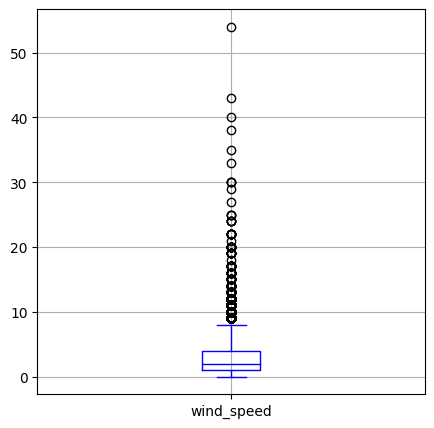

In [50]:
df2 = df2[df2.wind_speed<=60]
df2.boxplot(column='wind_speed', color="blue",figsize=(5, 5))

Last step is to convert temp, temp_min and temp_max from kelvin to celsius - simply subtract 273.15 and round to 1 decimal place and create new columns temp_C, temp_C_min, temp_C_max, then delete the temp, temp_max amd temp_min columns.

In [51]:
# convert from Kelvin to Celcuis by subtracting 273.15 and create new columns temp_C, temp_C_min, temp_C_max
df2['temp_C'] = round((df2['temp']-273.15),1)
df2['temp_C_max'] = round((df2['temp_max']-273.15),1)
df2['temp_C_min'] = round((df2['temp_min']-273.15),1)

In [52]:
df2.drop(columns = ['temp','temp_max','temp_min'], axis=1, inplace=True)

<Axes: >

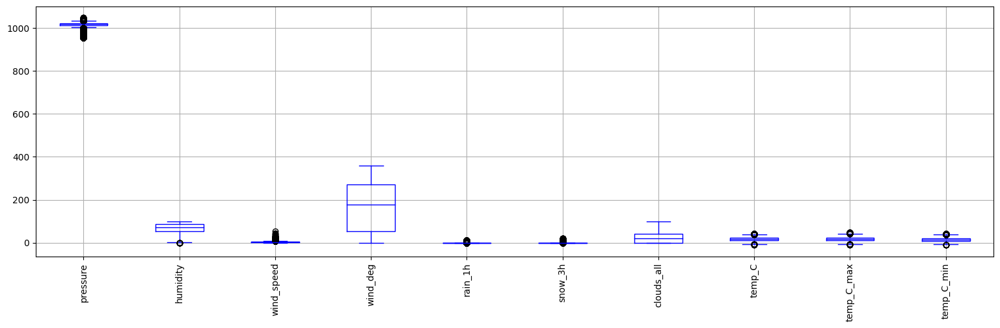

In [53]:
# boxplots for all features with labels rotated for readability.
df2.boxplot(rot='vertical', color="blue",figsize=(19,5))
# can do similar plot for df_joined_pred

<Axes: >

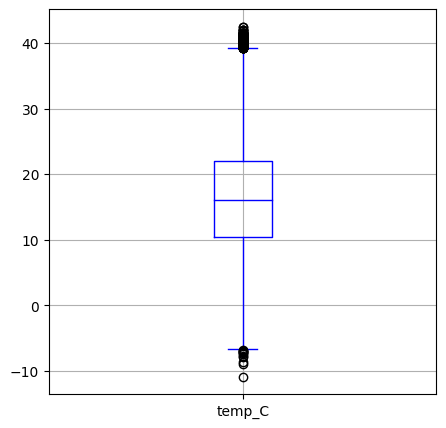

In [54]:
df2 = df2[df2.temp_C<=100]
df2.boxplot(column='temp_C', color="blue",figsize=(5, 5))

In [55]:
# find the names of the cities that have data
df2['city_name'].unique()

array(['Valencia', 'Madrid', 'Bilbao', ' Barcelona', 'Seville'],
      dtype=object)

Cities in the dataset are 'Valencia', 'Madrid', 'Bilbao', ' Barcelona', 'Seville

Plotting the daily temperatures of each city. It shows the Seville (black) seems to have the highest temperatures and Bilbao (blue) and Madrid (red) have the lowest but the all follow the seasonal pattern.

Text(0.5, 0, 'Year')

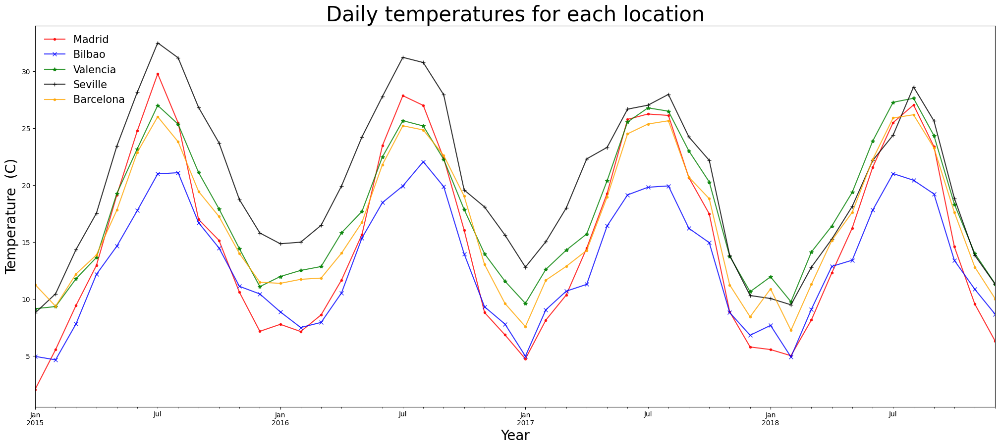

In [ ]:
# Plots of monthly temps for all 3 cities - to make reasmpling daily change the resample("M") to D or W for weekly
axes = df2[df2.city_name=='Madrid'    ]["temp_C"].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='Madrid', color='red' )
axes = df2[df2.city_name=='Bilbao'    ]["temp_C"].resample("M").mean().plot(marker='x', alpha=0.8,  figsize=(25,10), label='Bilbao', color='blue')
axes = df2[df2.city_name=='Valencia'  ]["temp_C"].resample("M").mean().plot(marker='*', alpha=0.8,  figsize=(25,10), label='Valencia', color='green')
axes = df2[df2.city_name=='Seville'   ]["temp_C"].resample("M").mean().plot(marker='+', alpha=0.8,  figsize=(25,10), label='Seville', color='black')
axes = df2[df2.city_name==' Barcelona']["temp_C"].resample("M").mean().plot(marker='.', alpha=0.8,  figsize=(25,10), label='Barcelona', color='orange')
axes.legend(loc='upper left', frameon=False, fontsize=15)
axes.set_title('Daily temperatures for each location', fontsize=30)
axes.set_ylabel('Temperature  (C)', fontsize=20)
axes.set_xlabel("Year", fontsize=20)

The dataset is unique because it contains hourly data for electrical consumption and the respective forecasts by the TSO for consumption and pricing. This allows prospective forecasts to be benchmarked against the current state of the art forecasts being used in industry.

" Research Questions"
1. Which regression technique will accurately forecast the daily energy consumption demand using hourly period.

2. How to accurately forecast energy demand 24 hour in advance compared to TSO?

3. Using Classification, determine what weather measurements, and cities influence most the electrical demand, prices, generation capacity?


**Q1.**
**Which regression technique will accurately forecast the daily energy consumption demand using hourly period.**

Text(0.5, 1.0, 'Hourly boxplots of total load')

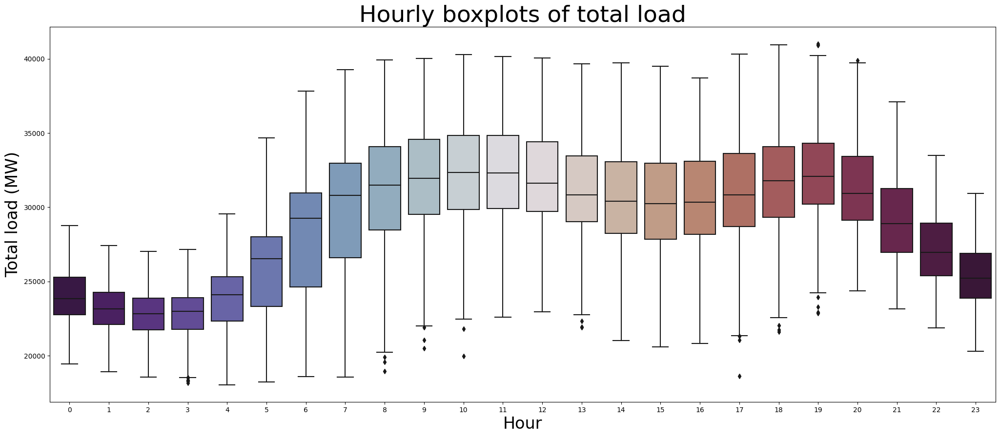

In [ ]:
# Visualise by total actual load by hour

sns.boxplot(x=df1.index.hour, y='total load actual', data=df1,palette="twilight_shifted")
plt.ylabel('Total load (MW)', fontsize=24)
plt.xlabel('Hour', fontsize=24)
plt.title("Hourly boxplots of total load", fontsize=34)

from the above graph it seems there are still some problems with outliers - will deal with later if i get the chance - future work

By month the greatest usage is in winter months January and February, and lowest in spring April/May and then high again in summer June/July, this links in to the idea that there is greater enery demand in either hot or cold conditions

Text(0.5, 1.0, 'Monthly boxplots of total load Actual')

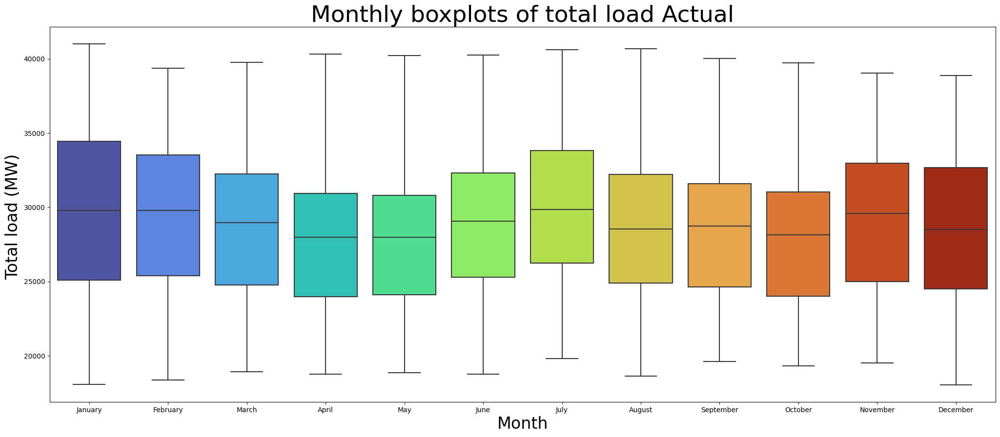

In [ ]:
# Now to visualise load by month

sns.boxplot(x=df1.index.month_name(), y='total load actual', data=df1, palette="turbo")
plt.ylabel('Total load (MW) ', fontsize=24)
plt.xlabel('Month', fontsize=24)
plt.title("Monthly boxplots of total load Actual", fontsize=34)

Another interesting view is Total Load by day of week - this matches our understanding - most days are similar with Saturday much less and Sunday the least.

Text(0.5, 1.0, 'Daily boxplots of total load actual')

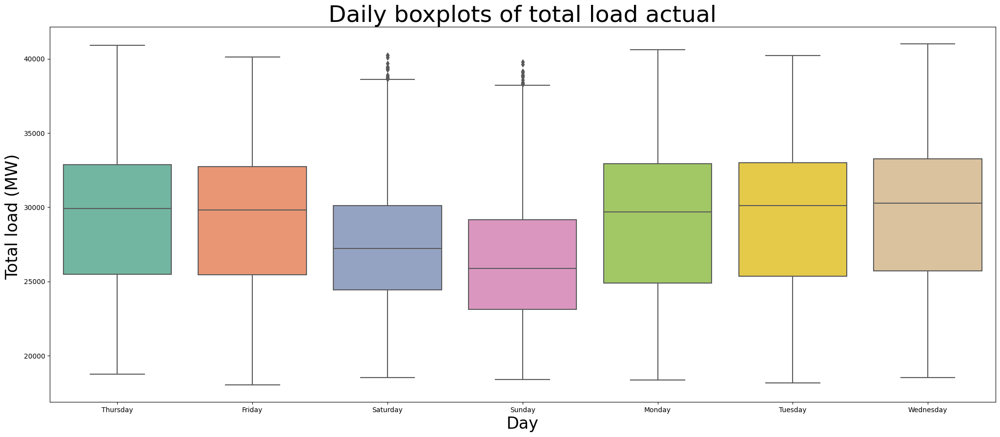

In [ ]:
# Now to visualise load by day

sns.boxplot(x=df1.index.day_name(), y='total load actual', data=df1, palette="Set2")
plt.ylabel('Total load (MW) ', fontsize=24)
plt.xlabel('Day', fontsize=24)
plt.title("Daily boxplots of total load actual", fontsize=34)

To model the timeseries as multivariate it becomes necessary to join the weather and energy datasets and look for some correlations. Need to use merge to join the datasets based on their common index values (don't want duplicates).

Since there are weather values for all 5 cities take the mean across all the cities - this will miss some extremes but is an easy way to summarise the weather df and then join with the energy df

In [56]:
# Create a combined df of the information from the 5 cities by taking the mean of the values for each hour.
df2_combined = df2.resample("H").mean()
df2_combined.index.rename('Datetime', inplace=True)

<ipython-input-56-1b9788304e5f>:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df2_combined = df2.resample("H").mean()


In [57]:
df2_combined.head()

,pressure,humidity,wind_speed,wind_deg,rain_1h,snow_3h,clouds_all,temp_C,temp_C_max,temp_C_min
Datetime,,,,,,,,,,
2015-01-01 00:00:00,1016.2,82.4,2.0,135.8,0.0,0.0,0.0,-0.64,-0.64,-0.64
2015-01-01 01:00:00,1016.8,82.0,2.4,119.0,0.0,0.0,0.0,-1.08,-1.08,-1.08
2015-01-01 02:00:00,1035.0,97.0,1.0,225.0,0.0,0.0,0.0,-3.90,-3.90,-3.90
2015-01-01 03:00:00,1035.0,97.0,1.0,221.0,0.0,0.0,0.0,-3.70,-3.70,-3.70
2015-01-01 04:00:00,1017.4,82.6,2.4,174.8,0.0,0.0,0.0,-1.14,-1.14,-1.14


In [58]:
df2_combined.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 35063 entries, 2015-01-01 00:00:00 to 2018-12-31 22:00:00
Freq: H
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   pressure    34468 non-null  float64
 1   humidity    34468 non-null  float64
 2   wind_speed  34468 non-null  float64
 3   wind_deg    34468 non-null  float64
 4   rain_1h     34468 non-null  float64
 5   snow_3h     34468 non-null  float64
 6   clouds_all  34468 non-null  float64
 7   temp_C      34468 non-null  float64
 8   temp_C_max  34468 non-null  float64
 9   temp_C_min  34468 non-null  float64
dtypes: float64(10)
memory usage: 2.9 MB


In [59]:
df2_combined.shape

(35063, 10)

In [60]:
df1.index.rename('Datetime', inplace=True)
df1.index.name

'Datetime'

In [61]:
# Next join the 2 datasets on the common index
df_joined = df2_combined.merge(df1, on='Datetime', how = 'inner')

In [62]:
display(df_joined.head())

,pressure,humidity,wind_speed,wind_deg,rain_1h,snow_3h,clouds_all,temp_C,temp_C_max,temp_C_min,...,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual,total generation
Datetime,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,1016.2,82.4,2.0,135.8,0.0,0.0,0.0,-0.64,-0.64,-0.64,...,50.0,195.0,5890.0,16.0,5856.0,24934.0,24382.0,48.10,64.92,26883.0
2015-01-01 01:00:00,1016.8,82.0,2.4,119.0,0.0,0.0,0.0,-1.08,-1.08,-1.08,...,50.0,196.0,5461.0,8.0,5454.0,23515.0,22734.0,47.33,64.48,25868.0
2015-01-01 02:00:00,1035.0,97.0,1.0,225.0,0.0,0.0,0.0,-3.90,-3.90,-3.90,...,50.0,191.0,5238.0,2.0,5151.0,22642.0,21286.0,42.27,59.32,24371.0
2015-01-01 03:00:00,1035.0,97.0,1.0,221.0,0.0,0.0,0.0,-3.70,-3.70,-3.70,...,42.0,189.0,4935.0,9.0,4861.0,21785.0,20264.0,38.41,56.04,23849.0
2015-01-01 04:00:00,1017.4,82.6,2.4,174.8,0.0,0.0,0.0,-1.14,-1.14,-1.14,...,34.0,188.0,4618.0,4.0,4617.0,21441.0,19905.0,35.72,53.63,23487.0


In [63]:
df_joined.index

DatetimeIndex(['2015-01-01 00:00:00', '2015-01-01 01:00:00',
               '2015-01-01 02:00:00', '2015-01-01 03:00:00',
               '2015-01-01 04:00:00', '2015-01-01 05:00:00',
               '2015-01-01 06:00:00', '2015-01-01 07:00:00',
               '2015-01-01 08:00:00', '2015-01-01 09:00:00',
               ...
               '2018-12-31 13:00:00', '2018-12-31 14:00:00',
               '2018-12-31 15:00:00', '2018-12-31 16:00:00',
               '2018-12-31 17:00:00', '2018-12-31 18:00:00',
               '2018-12-31 19:00:00', '2018-12-31 20:00:00',
               '2018-12-31 21:00:00', '2018-12-31 22:00:00'],
              dtype='datetime64[ns]', name='Datetime', length=35063, freq=None)

In [64]:
df_joined.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 35063 entries, 2015-01-01 00:00:00 to 2018-12-31 22:00:00
Data columns (total 31 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   pressure                                     34468 non-null  float64
 1   humidity                                     34468 non-null  float64
 2   wind_speed                                   34468 non-null  float64
 3   wind_deg                                     34468 non-null  float64
 4   rain_1h                                      34468 non-null  float64
 5   snow_3h                                      34468 non-null  float64
 6   clouds_all                                   34468 non-null  float64
 7   temp_C                                       34468 non-null  float64
 8   temp_C_max                                   34468 non-null  float64
 9   temp_C_min                           

In [65]:
df_joined.isna().sum()

pressure                                       595
humidity                                       595
wind_speed                                     595
wind_deg                                       595
rain_1h                                        595
snow_3h                                        595
clouds_all                                     595
temp_C                                         595
temp_C_max                                     595
temp_C_min                                     595
generation biomass                               0
generation fossil brown coal/lignite             0
generation fossil gas                            0
generation fossil hard coal                      0
generation fossil oil                            0
generation hydro pumped storage consumption      0
generation hydro run-of-river and poundage       0
generation hydro water reservoir                 0
generation nuclear                               0
generation other               

In [66]:
df_joined.dropna(inplace=True)

In [67]:
df_joined.isna().sum()

pressure                                       0
humidity                                       0
wind_speed                                     0
wind_deg                                       0
rain_1h                                        0
snow_3h                                        0
clouds_all                                     0
temp_C                                         0
temp_C_max                                     0
temp_C_min                                     0
generation biomass                             0
generation fossil brown coal/lignite           0
generation fossil gas                          0
generation fossil hard coal                    0
generation fossil oil                          0
generation hydro pumped storage consumption    0
generation hydro run-of-river and poundage     0
generation hydro water reservoir               0
generation nuclear                             0
generation other                               0
generation other ren

In [68]:
# check for duplicates -
df_joined.index.has_duplicates

False

In [69]:
df_joined.shape

(34468, 31)

In [70]:
df_joined.head()

,pressure,humidity,wind_speed,wind_deg,rain_1h,snow_3h,clouds_all,temp_C,temp_C_max,temp_C_min,...,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual,total generation
Datetime,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,1016.2,82.4,2.0,135.8,0.0,0.0,0.0,-0.64,-0.64,-0.64,...,50.0,195.0,5890.0,16.0,5856.0,24934.0,24382.0,48.10,64.92,26883.0
2015-01-01 01:00:00,1016.8,82.0,2.4,119.0,0.0,0.0,0.0,-1.08,-1.08,-1.08,...,50.0,196.0,5461.0,8.0,5454.0,23515.0,22734.0,47.33,64.48,25868.0
2015-01-01 02:00:00,1035.0,97.0,1.0,225.0,0.0,0.0,0.0,-3.90,-3.90,-3.90,...,50.0,191.0,5238.0,2.0,5151.0,22642.0,21286.0,42.27,59.32,24371.0
2015-01-01 03:00:00,1035.0,97.0,1.0,221.0,0.0,0.0,0.0,-3.70,-3.70,-3.70,...,42.0,189.0,4935.0,9.0,4861.0,21785.0,20264.0,38.41,56.04,23849.0
2015-01-01 04:00:00,1017.4,82.6,2.4,174.8,0.0,0.0,0.0,-1.14,-1.14,-1.14,...,34.0,188.0,4618.0,4.0,4617.0,21441.0,19905.0,35.72,53.63,23487.0


Creating a correlation matrix and displaying it shows a few interesting things. Namely the temperature only has a 20% correlation with the total load actual. Two graphs shown - one for all correlations and then one with absolute values for correlations greater than 40%, lastly the specific correlations can be viewed in a list (select the field manually).

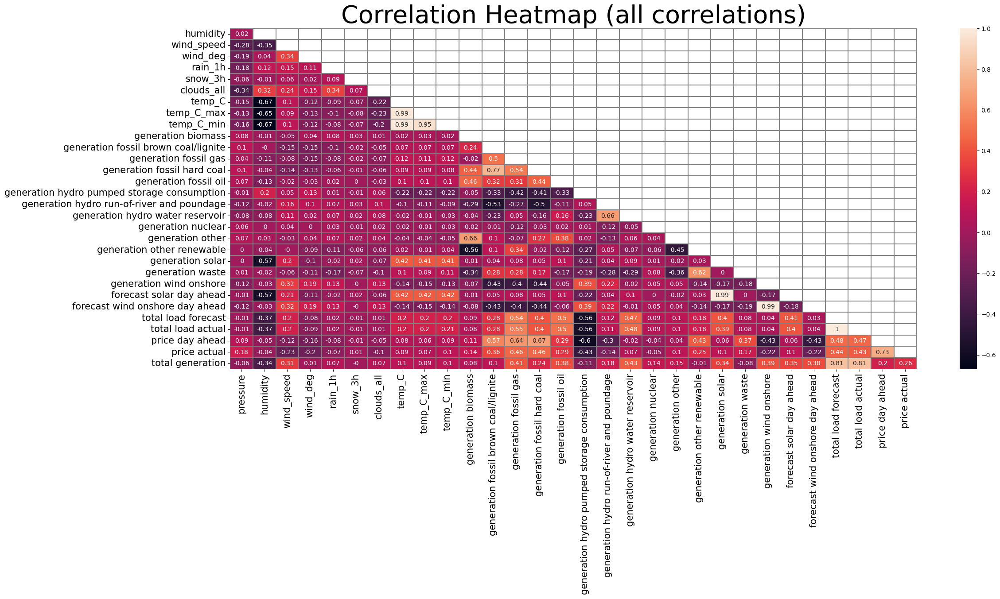

In [71]:
# To find the correlation among the columns using pearson method

corr_matrix = df_joined.corr().round(2) # add in .abs() if not worried about positive or negative correlation just the strength


# use this to show only lower triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
cut_off = -1 # to show all correlations

mask |= np.abs(corr_matrix) < cut_off
corr = corr_matrix[~mask]  # fill in NaN in the non-desired cells
# remove empty rows/columns to make it easier to read.
remove_empty_rows_and_cols = True
if remove_empty_rows_and_cols:
    wanted_cols = np.flatnonzero(np.count_nonzero(~mask, axis=1))
    wanted_rows = np.flatnonzero(np.count_nonzero(~mask, axis=0))
    corr = corr.iloc[wanted_cols, wanted_rows]
# display the correlation value in a grid to make it easier to read.
s = sns.heatmap(corr,annot=True,  linewidths=0.1, linecolor='gray')
# increase the size of the labels.
s.set_title('Correlation Heatmap (all correlations)', fontsize=40)
s.set_xticklabels(s.get_xmajorticklabels(), fontsize = 15)
s.set_yticklabels(s.get_ymajorticklabels(), fontsize = 15)
plt.show()
# can do it for again after feature creation

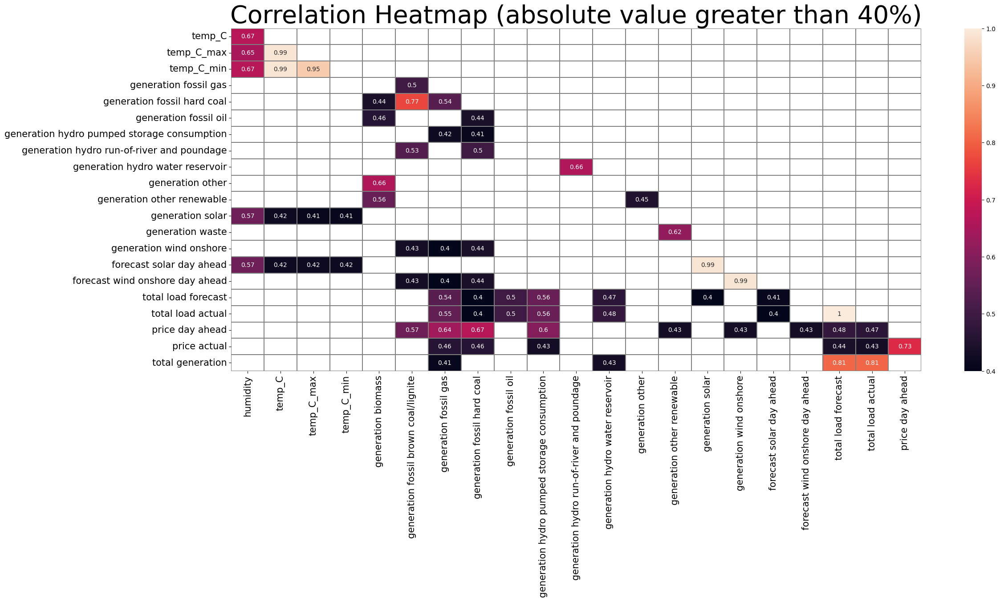

In [72]:
# To find the correlation among the columns using pearson method and then only display values with correlations > 40%

corr_matrix = df_joined.corr().abs().round(2) # add in .abs() if not worried about positive or negative correlation just the strength


# use this to show only lower triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
cut_off = 0.40 # just show correlation greater than 40%

mask |= np.abs(corr_matrix) < cut_off
corr = corr_matrix[~mask]  # fill in NaN in the non-desired cells
# reove empty rows/columns to make it easier to read.
remove_empty_rows_and_cols = True
if remove_empty_rows_and_cols:
    wanted_cols = np.flatnonzero(np.count_nonzero(~mask, axis=1))
    wanted_rows = np.flatnonzero(np.count_nonzero(~mask, axis=0))
    corr = corr.iloc[wanted_cols, wanted_rows]
# display the correlation value in a grid to make it easier to read.
s = sns.heatmap(corr,annot=True,  linewidths=0.1, linecolor='gray')
# increase the size of the labels.
s.set_title('Correlation Heatmap (absolute value greater than 40%)', fontsize=40)
s.set_xticklabels(s.get_xmajorticklabels(), fontsize = 15)
s.set_yticklabels(s.get_ymajorticklabels(), fontsize = 15)
plt.show()


Another way of viewing the correlations - this list can be changed to see different specific correlations - just change the specified field in the last line.

In [74]:
# way of viewing specific correlations
correlations = df_joined.corr().unstack().sort_values(ascending=False).drop_duplicates().round(2)
correlations['total load forecast']  # change the required field here to get the specific correlations

total load actual                              1.00
generation fossil gas                          0.54
price day ahead                                0.48
generation hydro water reservoir               0.47
forecast solar day ahead                       0.41
generation solar                               0.40
generation fossil hard coal                    0.40
generation fossil brown coal/lignite           0.28
temp_C                                         0.20
wind_speed                                     0.20
temp_C_max                                     0.20
generation other                               0.10
generation nuclear                             0.09
forecast wind onshore day ahead                0.03
rain_1h                                        0.02
pressure                                      -0.01
snow_3h                                       -0.01
wind_deg                                      -0.08
generation hydro pumped storage consumption   -0.56
dtype: float

In [75]:
correlations['humidity']  # change the required field here to get the specific correlations

clouds_all                          0.32
generation nuclear                 -0.00
generation biomass                 -0.01
snow_3h                            -0.01
forecast wind onshore day ahead    -0.03
generation wind onshore            -0.03
generation hydro water reservoir   -0.08
generation fossil oil              -0.13
wind_speed                         -0.35
total load forecast                -0.37
forecast solar day ahead           -0.57
temp_C_max                         -0.65
dtype: float64

In [76]:
correlations['wind_speed']

forecast wind onshore day ahead         0.32
clouds_all                              0.24
forecast solar day ahead                0.21
generation solar                        0.20
temp_C_min                              0.10
temp_C_max                              0.09
generation other renewable             -0.00
generation fossil oil                  -0.02
generation waste                       -0.06
generation fossil hard coal            -0.14
generation fossil brown coal/lignite   -0.15
pressure                               -0.28
dtype: float64

In [77]:
correlations['temp_C']

temp_C_min                         0.99
forecast solar day ahead           0.42
total load actual                  0.20
wind_speed                         0.10
generation fossil oil              0.10
total generation                   0.10
price actual                       0.09
generation biomass                 0.02
generation other renewable         0.02
generation other                  -0.04
wind_deg                          -0.12
generation wind onshore           -0.14
forecast wind onshore day ahead   -0.14
pressure                          -0.15
clouds_all                        -0.22
humidity                          -0.67
dtype: float64

In [78]:
correlations['price actual']

generation fossil hard coal                    0.46
total load forecast                            0.44
generation other renewable                     0.25
generation hydro water reservoir               0.07
humidity                                      -0.04
rain_1h                                       -0.07
clouds_all                                    -0.10
generation hydro run-of-river and poundage    -0.14
wind_deg                                      -0.20
wind_speed                                    -0.23
generation hydro pumped storage consumption   -0.43
dtype: float64

In [79]:
correlations['price day ahead']

price actual                            0.73
generation fossil hard coal             0.67
generation fossil brown coal/lignite    0.57
total load actual                       0.47
generation other renewable              0.43
generation waste                        0.37
generation fossil oil                   0.29
total generation                        0.20
generation biomass                      0.11
temp_C_min                              0.09
pressure                                0.09
temp_C                                  0.08
forecast solar day ahead                0.06
snow_3h                                -0.01
humidity                               -0.05
clouds_all                             -0.05
wind_speed                             -0.12
generation wind onshore                -0.43
forecast wind onshore day ahead        -0.43
dtype: float64

In [80]:
correlations['total generation']

total load forecast                0.81
generation fossil gas              0.41
forecast wind onshore day ahead    0.38
generation fossil oil              0.38
forecast solar day ahead           0.35
generation solar                   0.34
wind_speed                         0.31
price actual                       0.26
temp_C_min                         0.10
clouds_all                         0.07
snow_3h                           -0.00
pressure                          -0.06
generation waste                  -0.08
humidity                          -0.34
dtype: float64

Since we are trying to predict the total load actual value, the values correlated to that need to be included as predictors - from below we can see that the values to use are :

['total generation','generation fossil gas','generation fossil oil','generation hydro water reservoir','price actual','generation fossil hard coal','temp_C_max','generation other renewable','generation fossil brown coal/lignite,'forecast solar day ahead','wind_speed','humidity','generation hydro run-of-river and poundage','rain_1h', 'generation nuclear', 'generation biomass']    

In [81]:
correlations['total load actual'] # dependent variable

total generation                              0.81
generation fossil oil                         0.50
generation hydro water reservoir              0.48
price actual                                  0.43
forecast solar day ahead                      0.40
generation fossil hard coal                   0.40
generation fossil brown coal/lignite          0.28
wind_speed                                    0.20
temp_C_max                                    0.20
generation other renewable                    0.18
generation hydro run-of-river and poundage    0.11
generation nuclear                            0.09
generation biomass                            0.08
generation waste                              0.08
rain_1h                                       0.02
clouds_all                                    0.01
snow_3h                                      -0.01
humidity                                     -0.37
dtype: float64

So the target variable is the total load actual and the predictors are as above.

In [82]:
display(df_joined.describe())

,pressure,humidity,wind_speed,wind_deg,rain_1h,snow_3h,clouds_all,temp_C,temp_C_max,temp_C_min,...,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual,total generation
count,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,...,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000
mean,1017.028650,68.169692,2.457049,167.625482,0.080978,0.006841,25.279949,16.480703,17.989742,15.154977,...,1436.978255,269.056350,5484.693281,1442.346843,5490.735146,28715.910149,28703.639763,49.854442,57.865639,27515.312975
std,7.373128,14.942722,1.386327,59.894127,0.233266,0.145347,18.031115,7.242166,7.504520,7.087954,...,1682.309161,50.386122,3218.273470,1679.388982,3180.359741,4593.997168,4575.739217,14.645664,14.235884,4103.904234
min,972.000000,22.600000,0.000000,0.000000,0.000000,0.000000,0.000000,-3.900000,-3.900000,-3.900000,...,-8.231370,0.000000,0.000000,0.000000,237.000000,18105.000000,18041.000000,2.060000,9.330000,6899.000000
25%,1013.500000,56.800000,1.400000,126.000000,0.000000,0.000000,12.000000,10.820000,12.200000,9.780000,...,71.000000,239.000000,2952.000000,70.750000,2998.000000,24796.750000,24811.000000,41.430000,49.330000,24391.750000
50%,1017.200000,69.600000,2.200000,167.600000,0.000000,0.000000,23.000000,15.800000,17.320000,14.480000,...,618.000000,279.000000,4874.000000,577.000000,4879.000000,28905.000000,28904.500000,50.540000,58.030000,27368.000000
75%,1021.200000,80.000000,3.200000,210.000000,0.060000,0.000000,35.000000,21.860000,23.600000,20.360000,...,2592.250000,310.000000,7432.000000,2641.000000,7379.000000,32264.000000,32195.000000,60.530000,68.010000,30372.000000
max,1039.800000,100.000000,20.000000,357.000000,5.000000,7.166667,94.000000,36.120000,40.380000,35.400000,...,5792.000000,357.000000,17436.000000,5836.000000,17430.000000,41390.000000,41015.000000,101.990000,116.800000,40810.000000


In [83]:
#Check the data types of the attributes.
from numpy.lib import type_check
print(df_joined.dtypes)

pressure                                       float64
humidity                                       float64
wind_speed                                     float64
wind_deg                                       float64
rain_1h                                        float64
snow_3h                                        float64
clouds_all                                     float64
temp_C                                         float64
temp_C_max                                     float64
temp_C_min                                     float64
generation biomass                             float64
generation fossil brown coal/lignite           float64
generation fossil gas                          float64
generation fossil hard coal                    float64
generation fossil oil                          float64
generation hydro pumped storage consumption    float64
generation hydro run-of-river and poundage     float64
generation hydro water reservoir               float64
generation

#Ploting histogram

<Axes: >

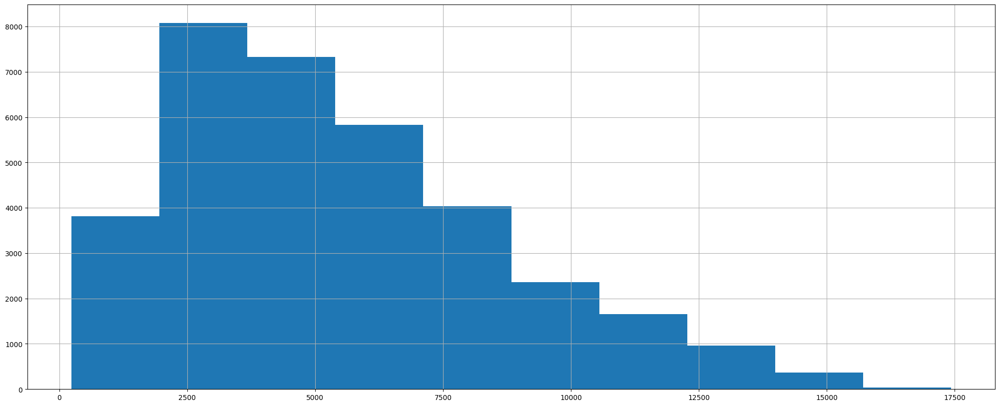

In [ ]:
df_joined['forecast wind onshore day ahead'].hist()

<Axes: >

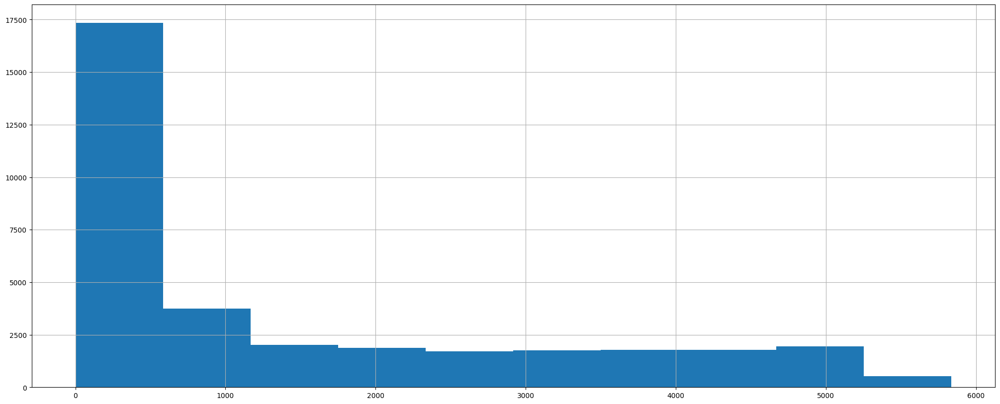

In [ ]:
df_joined['forecast solar day ahead'].hist()

<Axes: >

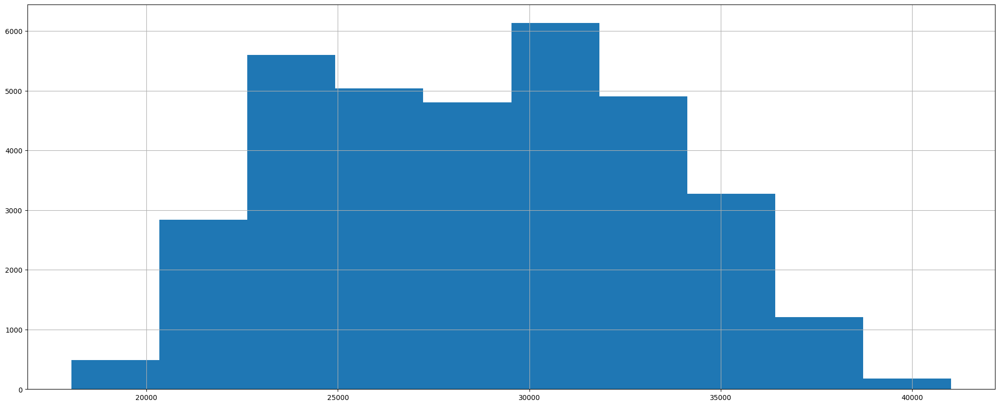

In [ ]:
df_joined['total load actual'].hist()

<Axes: >

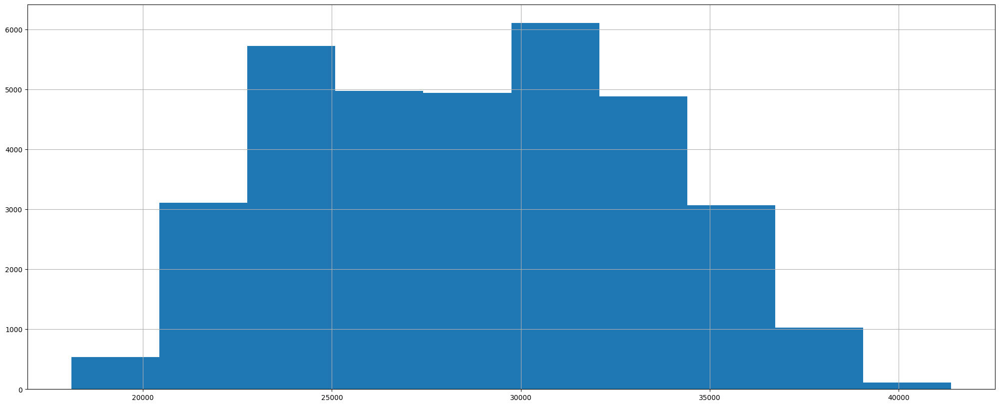

In [ ]:
df_joined['total load forecast'].hist()

<Axes: >

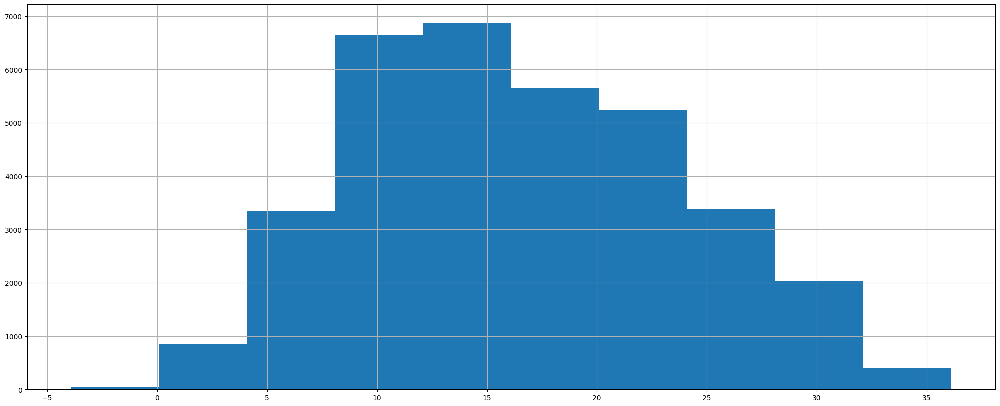

In [ ]:
df_joined['temp_C'].hist()

<Axes: >

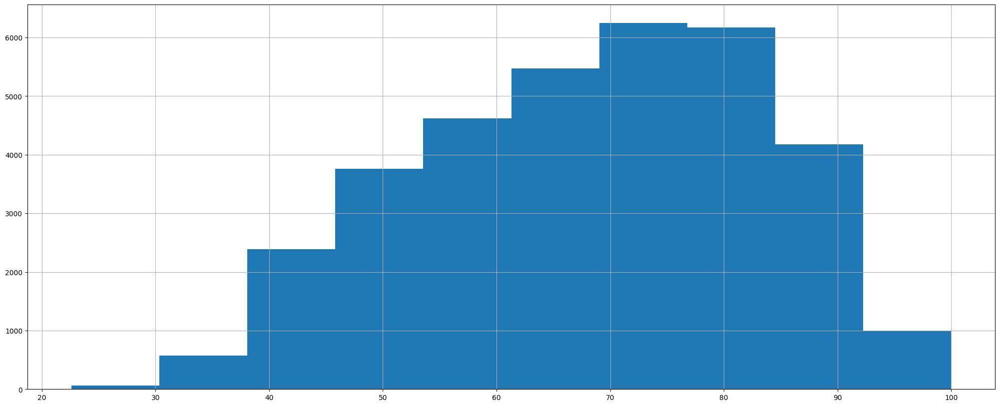

In [ ]:
df_joined['humidity'].hist()

<Axes: >

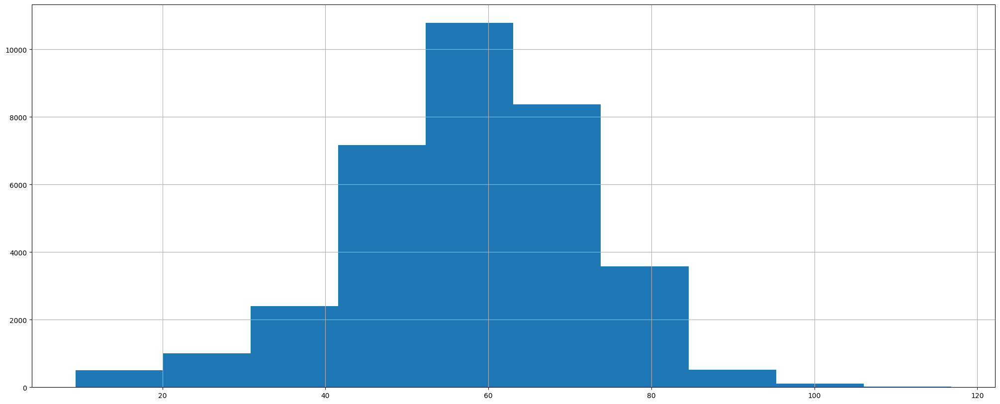

In [ ]:
df_joined['price actual'].hist()

<Axes: >

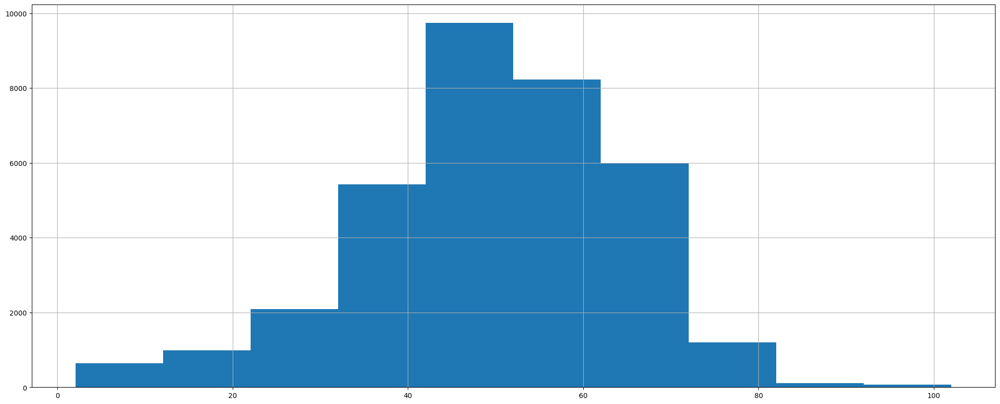

In [ ]:
df_joined['price day ahead'].hist()

<Axes: >

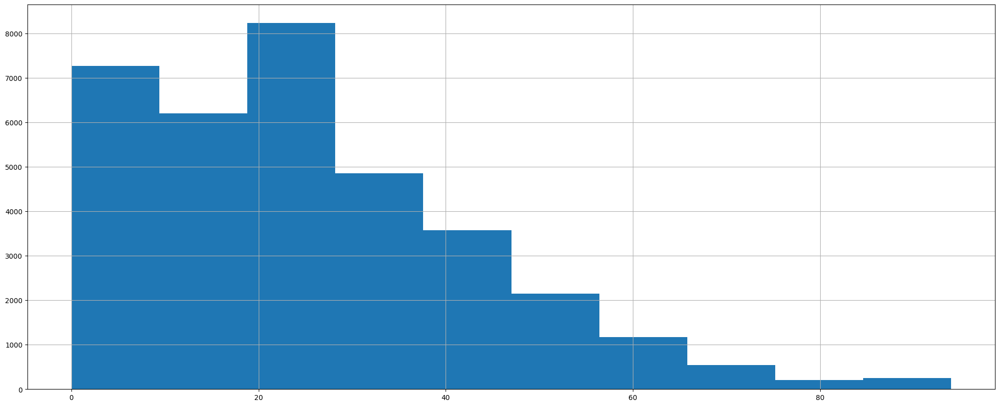

In [ ]:
df_joined['clouds_all'].hist()

<Axes: >

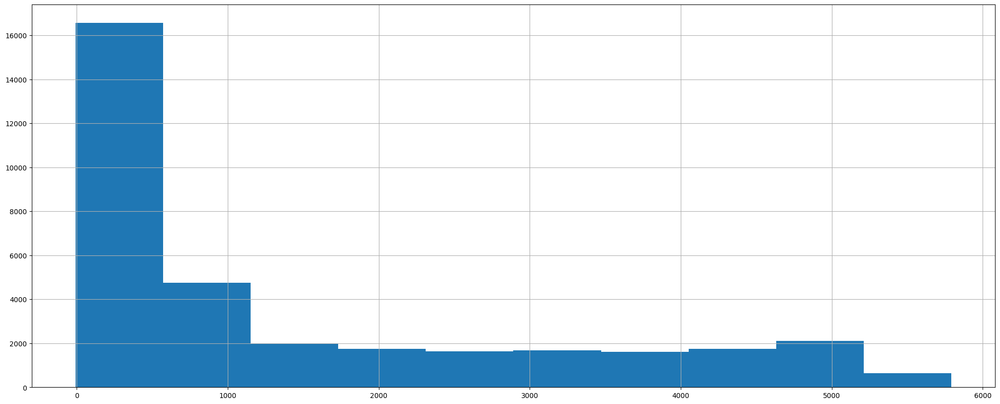

In [ ]:
df_joined['generation solar'].hist()

<Axes: >

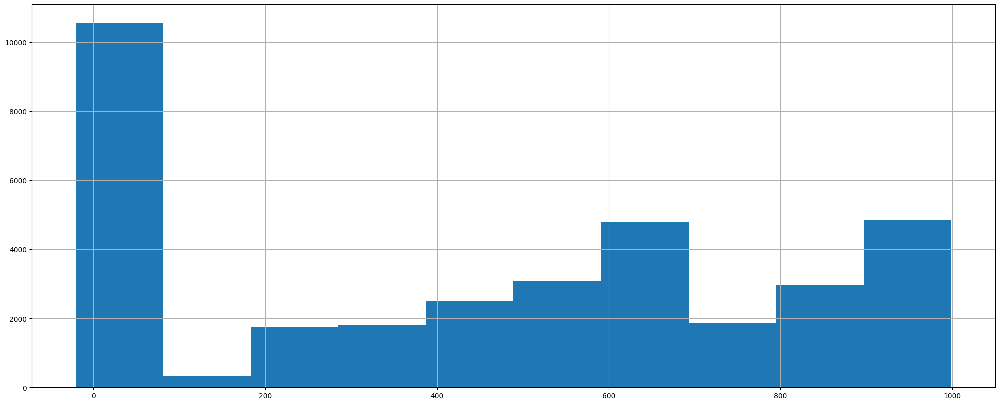

In [ ]:
df_joined['generation fossil brown coal/lignite'].hist()

<Axes: >

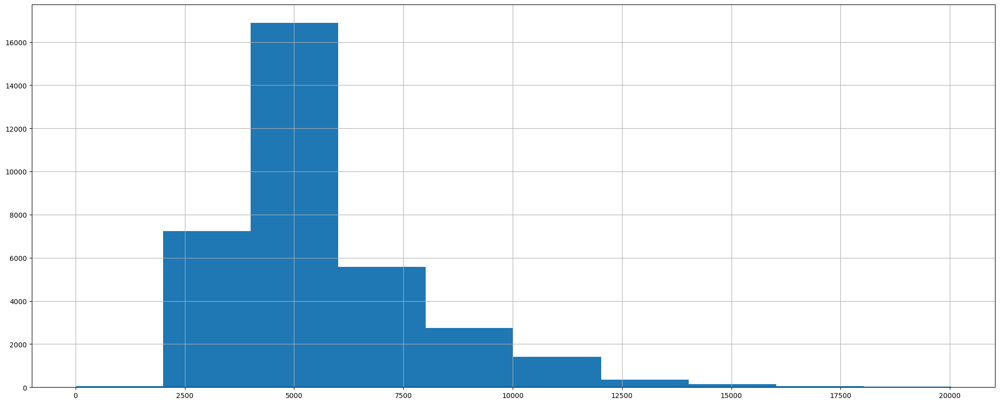

In [ ]:
df_joined['generation fossil gas'].hist()

<Axes: >

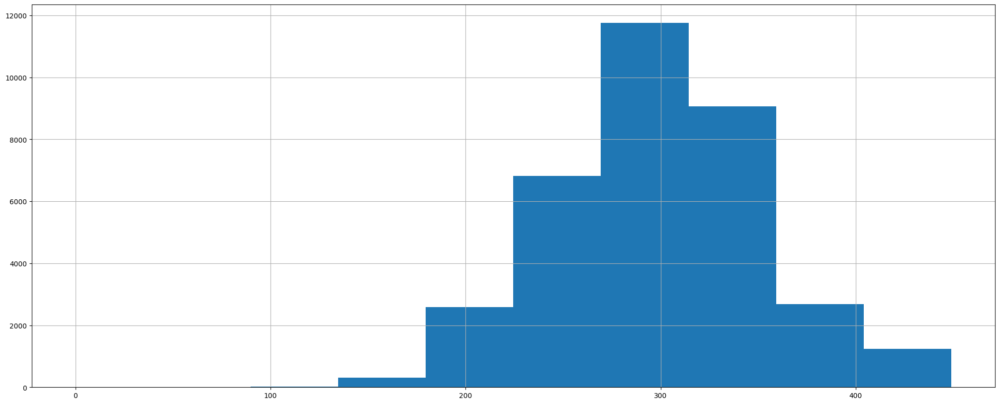

In [ ]:
df_joined['generation fossil oil'].hist()

<Axes: >

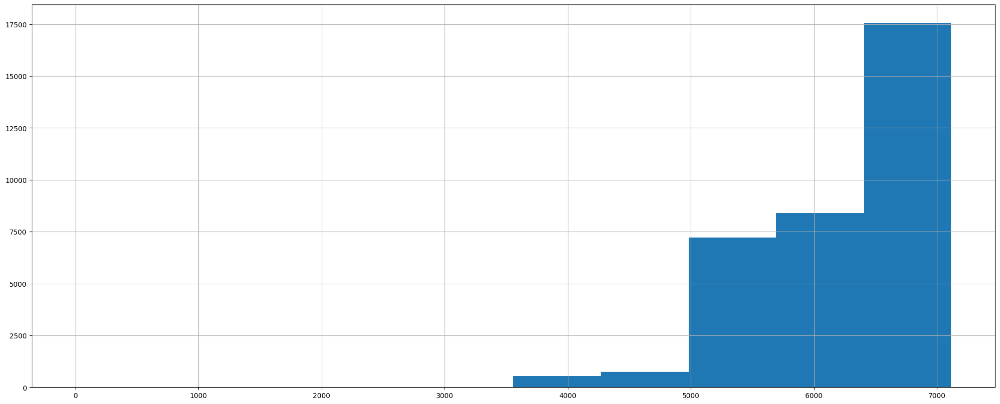

In [ ]:
df_joined['generation nuclear'].hist()

<Axes: >

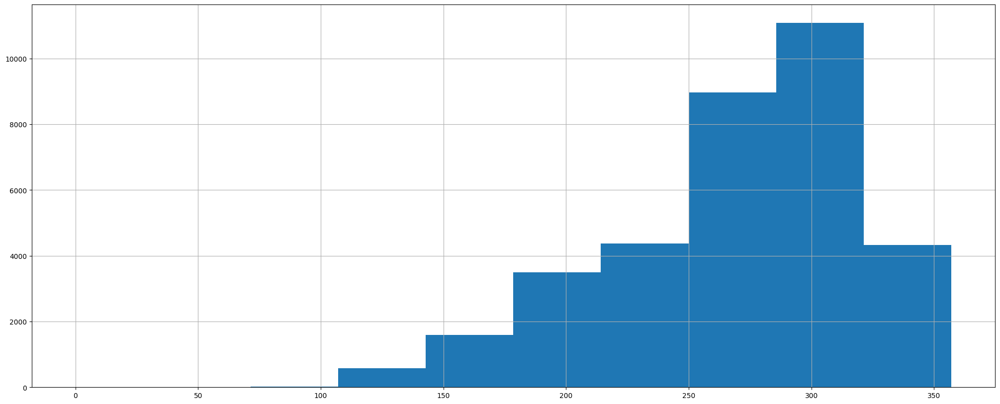

In [ ]:
df_joined['generation waste'].hist()

<Axes: >

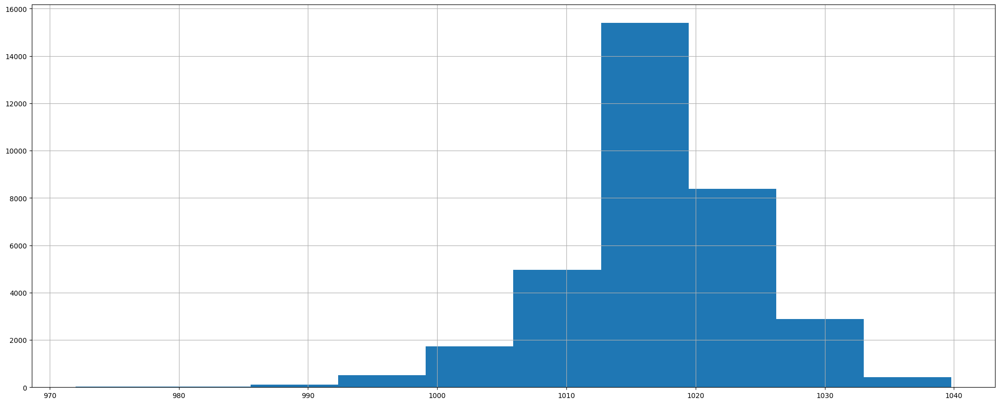

In [ ]:
df_joined['pressure'].hist()

<Axes: >

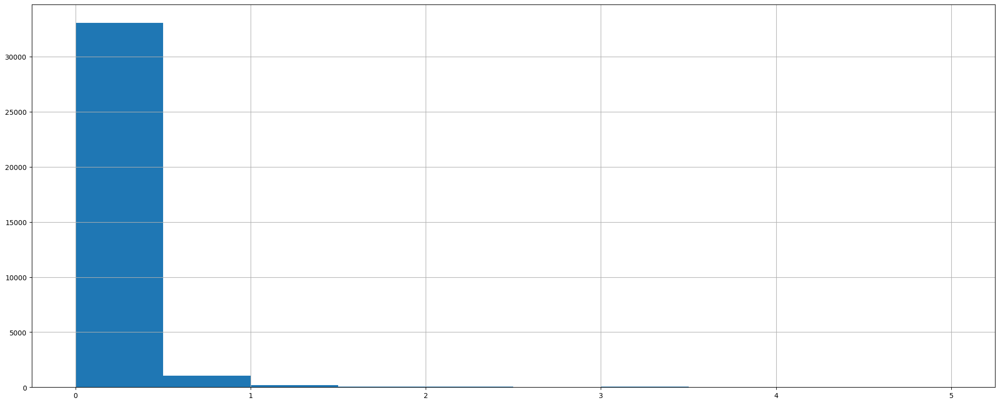

In [ ]:
df_joined['rain_1h'].hist()

<Axes: >

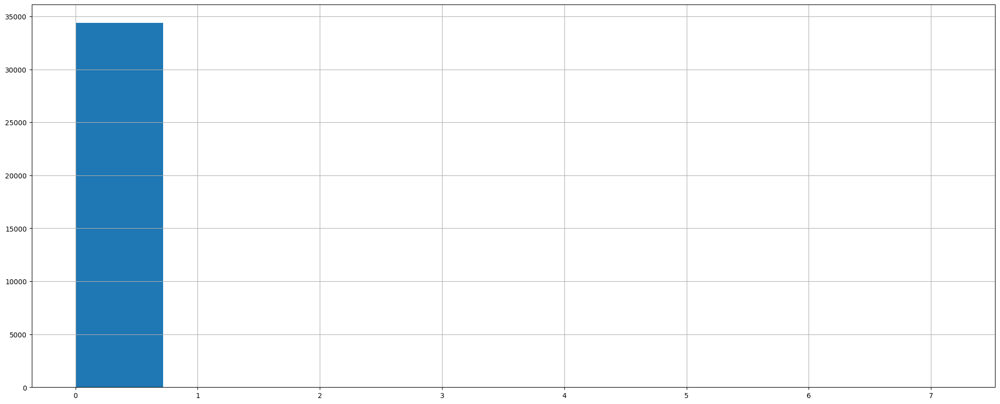

In [ ]:
df_joined['snow_3h'].hist()

<Axes: >

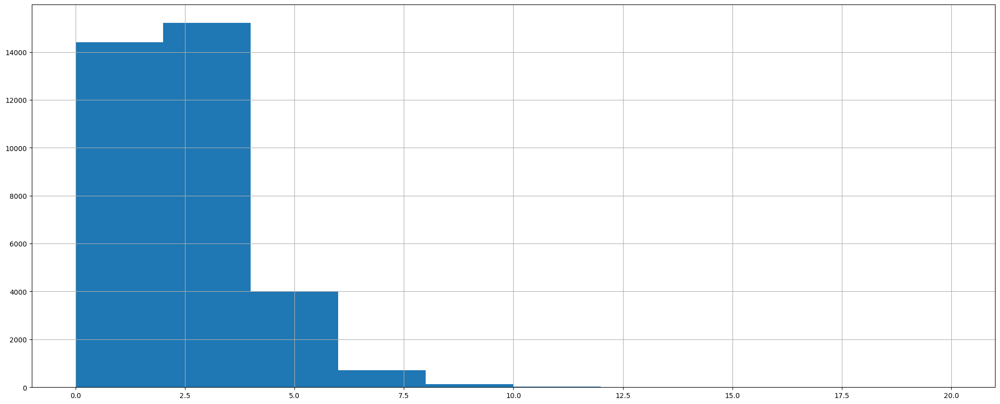

In [ ]:
df_joined['wind_speed'].hist()

<Axes: >

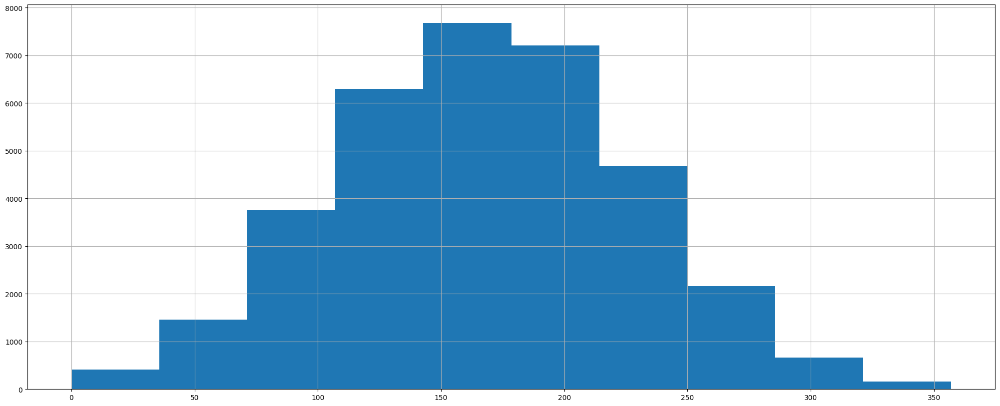

In [ ]:
df_joined['wind_deg'].hist()

Now to see if a multivariate model can be trained using this data

- first make a smaller dataframe with the variables needed, then set up y_train/test and X_train/test

In [84]:
# kind of Baseline Model
# I changed the dependent variable from total load forecast to total load actual
# create a new df; df_joined_pred - for prediction - only the correlated columns
df_joined_pred = df_joined[['total load actual','total generation','generation fossil gas','generation fossil oil','generation hydro water reservoir','price actual','generation fossil hard coal','temp_C_max','generation other renewable','generation fossil brown coal/lignite','forecast solar day ahead','wind_speed','humidity','generation hydro run-of-river and poundage','rain_1h', 'generation nuclear', 'generation biomass']]
df_joined_pred.head()

,total load actual,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,wind_speed,humidity,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass
Datetime,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,24382.0,26883.0,5196.0,158.0,1658.0,64.92,4755.0,-0.64,71.0,328.0,16.0,2.0,82.4,1009.0,0.0,7096.0,449.0
2015-01-01 01:00:00,22734.0,25868.0,4857.0,157.0,1371.0,64.48,4581.0,-1.08,73.0,323.0,8.0,2.4,82.0,973.0,0.0,7099.0,448.0
2015-01-01 02:00:00,21286.0,24371.0,4314.0,160.0,779.0,59.32,4131.0,-3.90,75.0,254.0,2.0,1.0,97.0,949.0,0.0,7098.0,438.0
2015-01-01 03:00:00,20264.0,23849.0,4130.0,156.0,720.0,56.04,3840.0,-3.70,74.0,187.0,9.0,1.0,97.0,953.0,0.0,7097.0,428.0
2015-01-01 04:00:00,19905.0,23487.0,4038.0,156.0,743.0,53.63,3590.0,-1.14,74.0,178.0,4.0,2.4,82.6,952.0,0.0,7098.0,410.0


In [85]:
df_joined_pred.shape

(34468, 17)

In [86]:
df_joined_pred
labels = np.array(df_joined_pred['total load actual'])
df_joined_pred_new = df_joined_pred.drop('total load actual', axis = 1)
df_joined_pred_new

train_instances, test_instances, train_labels, test_labels = train_test_split (df_joined_pred_new, labels, test_size = 0.20, random_state = 4180)

print('Training instances shape:', train_instances.shape)
print('Training labels shape:', train_labels.shape)
print('Testing instances shape:', test_instances.shape)
print('Testing labels shape:', test_labels.shape)


Training instances shape: (27574, 16)
Training labels shape: (27574,)
Testing instances shape: (6894, 16)
Testing labels shape: (6894,)


In [87]:
# This function helps evaluate our mean squared error, rmse, and the r2 score
def evaluate_results(TestLabel, TestPredictions):
    mse = round(mean_squared_error(TestLabel, TestPredictions), 2)
    rmse = math.sqrt(mse)
    r2_score_value = round(r2_score(TestLabel, TestPredictions), 2)

    print("mse  " + str(mse))
    print("rmse  "+ str(rmse))
    print("r2_score_value  " + str(r2_score_value))

In [88]:
# Linear Regression
regr = linear_model.LinearRegression()
model = regr.fit(train_instances, train_labels)

test_predictions = model.predict(test_instances)
test_predictions


array([29675.26338207, 32988.85406508, 27501.20044593, ...,
       27393.02063323, 27311.73810053, 21831.02020649])

In [89]:
train_labels

array([26701., 27266., 26679., ..., 31339., 35535., 35340.])

In [90]:
test_labels

array([29857., 35358., 28672., ..., 24626., 28243., 22024.])

My understanding is that test_prediction is taking training model and predict test_label. then error is calculated by find difference between test_label and test_prediction.

In [91]:
# Linear Regression Continued
evaluate_results(test_labels, test_predictions)
# can try on toal load forecast and total load actual

mse  3056344.74
rmse  1748.2404697294935
r2_score_value  0.85


Text(0, 0.5, 'Daily Totals (GWh)')

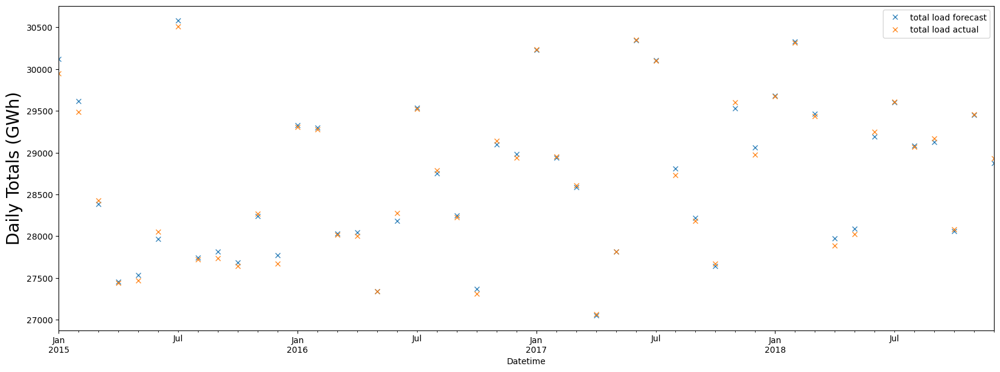

In [92]:
# LR load forecast vs actual - monthly resampled
total_load = ['total load forecast','total load actual']

group = df1[total_load].groupby(pd.Grouper(freq='M')).mean()
axes = group.plot(marker='x', alpha=0.9, linestyle='None', figsize=(20,7))
axes.set_ylabel('Daily Totals (GWh)', fontsize=20)
# can do similar for 4 reg model

In [93]:
# Python Function to return highest r2_score after consecutively training multiple KNN regression models
def evaluate_results2(TestLabel, TestPredictions):
    mse_2 = round(mean_squared_error(TestLabel, TestPredictions), 2)
    rmse_2 = math.sqrt(mse_2)
    r2_score_value_2 = round(r2_score(TestLabel, TestPredictions), 2)

    return r2_score_value_2


n = 5
max_r2_score = 0

while n <= 10:
    regr = KNeighborsRegressor (n_neighbors = n) #number of neighbors is arbitrary
    model = regr.fit(train_instances, train_labels)

    test_predictions = model.predict(test_instances)
    r2_score_value_2 = evaluate_results2(test_labels, test_predictions)

    if r2_score_value_2 >= max_r2_score:
        max_r2_score = r2_score_value_2

    n = n + 1

print ("Maximum r2_score_value " + str (max_r2_score))

Maximum r2_score_value 0.9


In [94]:
# KNN Regression
regr = KNeighborsRegressor (n_neighbors = 5) #number of neighbors is arbitrary
model = regr.fit(train_instances, train_labels)

test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)

mse  2045329.77
rmse  1430.1502613361995
r2_score_value  0.9


In [95]:
# Decision Tree Regression
regr = DecisionTreeRegressor(random_state = 42)
model = regr.fit(train_instances, train_labels)

test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)


mse  2864687.33
rmse  1692.5387233384056
r2_score_value  0.86


In [96]:
# Random Forest Regression
regr = RandomForestRegressor(random_state = 42, n_estimators = 10)
model = regr.fit(train_instances, train_labels)

test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)

mse  1334851.65
rmse  1155.3578017220466
r2_score_value  0.94


Therefore the best learned model is Random Forest Regression with R square of
 0.94 which means it can explain 94% of variation in dependent variable due to independent variables.

 Also RF regression has lowest RMSE of 1155.4

**Q2. How to accurately forecast energy demand 24 hour in advance compared to TSO?**



The way I am going to go about this is to forecast the energy use for the next day and compare that with the total load forecast feature for that day.
For this we need to develop a model and this requires splitting data into training and testing dataset so the accuracy of the model can be assessed.
The y value is simply the total load actual value from the energy data. Since we are trying to forecast 24 hours in advance better than the TSO the resampling should be daily.

First calculate the mean average percentage error (MAPE) from the forecast versus the actual to get the TSO error - for all years

A multivariate technique is required to use the given inputs more effectively

In [97]:
# For the hourly data
print('The mean absolute percentage error = {:.2f}%'.format(mean_absolute_percentage_error(df1['total load forecast'],df1['total load actual'])*100))

The mean absolute percentage error = 1.09%


In [98]:
# resampled daily
print('The mean absolute percentage error rsampled daily = {:.2f}%'.format(mean_absolute_percentage_error(df1['total load forecast'].resample('D').mean(),df1['total load actual'].resample('D').mean())*100))

The mean absolute percentage error rsampled daily = 0.82%


In [99]:
print('The RMSE error = {:.2f}%'.format(mean_squared_error(df1['total load actual'].resample('D').mean(),df1['total load forecast'].resample('D').mean(), squared=False)))
# or 3.09 which is way better than RF regressor which has rmse of 1155

The RMSE error = 309.22%


So the number that needs to be beaten to show we can forecast better than the TSO is a MAPE < 0.0082 or RMSE < 3.09

Feature Creation

In [100]:
def create_features(df_joined_pred_new):
  """
  Create time series features based on time series index
  """
  df_joined_pred_new = df_joined_pred_new.copy()
  df_joined_pred_new['hour'] = df_joined_pred_new.index.hour
  df_joined_pred_new['dayofweek'] = df_joined_pred_new.index.day_of_week # monday is zero and sunday is 6
  df_joined_pred_new['quarter'] = df_joined_pred_new.index.quarter
  df_joined_pred_new['month'] = df_joined_pred_new.index.month
  df_joined_pred_new['year'] = df_joined_pred_new.index.year
  df_joined_pred_new['dayofyear'] = df_joined_pred_new.index.dayofyear
  return df_joined_pred_new

df_joined_pred_new = create_features(df_joined_pred_new)

In [101]:
train_instances = create_features(train_instances)
test_instances = create_features(test_instances)

In [102]:
train_instances, test_instances, train_labels, test_labels = train_test_split (df_joined_pred_new, labels, test_size = 0.20, random_state = 4180)

print('Training instances shape:', train_instances.shape)
print('Training labels shape:', train_labels.shape)
print('Testing instances shape:', test_instances.shape)
print('Testing labels shape:', test_labels.shape)

Training instances shape: (27574, 22)
Training labels shape: (27574,)
Testing instances shape: (6894, 22)
Testing labels shape: (6894,)


In [103]:
df_joined_pred_new.head()

,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,...,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass,hour,dayofweek,quarter,month,year,dayofyear
Datetime,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,26883.0,5196.0,158.0,1658.0,64.92,4755.0,-0.64,71.0,328.0,16.0,...,1009.0,0.0,7096.0,449.0,0,3,1,1,2015,1
2015-01-01 01:00:00,25868.0,4857.0,157.0,1371.0,64.48,4581.0,-1.08,73.0,323.0,8.0,...,973.0,0.0,7099.0,448.0,1,3,1,1,2015,1
2015-01-01 02:00:00,24371.0,4314.0,160.0,779.0,59.32,4131.0,-3.90,75.0,254.0,2.0,...,949.0,0.0,7098.0,438.0,2,3,1,1,2015,1
2015-01-01 03:00:00,23849.0,4130.0,156.0,720.0,56.04,3840.0,-3.70,74.0,187.0,9.0,...,953.0,0.0,7097.0,428.0,3,3,1,1,2015,1
2015-01-01 04:00:00,23487.0,4038.0,156.0,743.0,53.63,3590.0,-1.14,74.0,178.0,4.0,...,952.0,0.0,7098.0,410.0,4,3,1,1,2015,1


In [104]:
# Linear Regression
regr = linear_model.LinearRegression()
model = regr.fit(train_instances, train_labels)

test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)

mse  2883111.95
rmse  1697.9728943655139
r2_score_value  0.86


creation time features improves the accuracy slightly

q2

In [105]:
def mape(actual, pred):
    actual, pred = np.array(actual), np.array(pred)
    return np.mean(np.abs((actual - pred) / actual)) * 100

Create a scaler to get all data on the same scale. Create the training, validation and testing datasets and use the scaler on them. Then define a function to create the X and y data in the right shape for feeding into the regresion models and use on each of the datasets. As we are trying to forecast the day ahead usage there are 2 approaches that can be taken:

The first of which is to resample the dataset on a daily basis (resample("D")) - and dropna as 1 rows of nas introduced

Use the hourly data and forecast 24 hours into the future

In [106]:
#using first approach

df_daily = df_joined_pred.resample("D").mean().dropna()

In [107]:
df_daily.describe()

,total load actual,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,wind_speed,humidity,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,28698.907756,27509.218976,5623.318285,298.335378,2606.306102,57.893889,4255.088371,17.963147,85.652293,448.007836,1439.186525,2.447086,68.342807,972.298913,0.080638,6263.293108,383.550165
std,2746.445765,2904.465060,1858.509647,46.464303,1420.797999,12.077190,1869.420469,6.728837,13.366486,338.442883,682.875561,0.961686,9.451103,392.329917,0.157678,816.618920,83.484737
min,21493.625000,20225.291667,1831.666667,147.333333,453.833333,14.514583,630.708333,3.070833,53.208333,0.000000,184.666667,0.913889,41.208333,339.291667,0.000000,3734.958333,185.333333
25%,27140.526225,25528.270833,4284.437500,268.937500,1528.406250,50.846667,2613.145833,12.530618,73.166667,23.375000,835.708333,1.841146,61.214063,640.875000,0.002500,5749.343750,334.281250
50%,28664.187500,27326.854167,5099.375000,300.062500,2284.854167,58.594792,4547.041667,17.190174,88.041667,516.208333,1409.104167,2.231250,68.161458,909.395833,0.024345,6568.291667,365.645833
75%,30813.135417,29339.052083,6498.291667,325.885417,3227.395833,66.575208,5686.268382,23.610615,96.875000,754.334280,2042.937500,2.786719,75.308085,1235.812500,0.092500,6993.625000,436.937500
max,35339.791667,36692.250000,14943.958333,417.791667,7428.750000,101.518571,7918.611111,32.115833,111.666667,973.333333,2983.777778,9.822917,94.075000,1911.304348,1.845000,7112.541667,574.541667


In [108]:
df_daily.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1460 entries, 2015-01-01 to 2018-12-31
Data columns (total 17 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   total load actual                           1460 non-null   float64
 1   total generation                            1460 non-null   float64
 2   generation fossil gas                       1460 non-null   float64
 3   generation fossil oil                       1460 non-null   float64
 4   generation hydro water reservoir            1460 non-null   float64
 5   price actual                                1460 non-null   float64
 6   generation fossil hard coal                 1460 non-null   float64
 7   temp_C_max                                  1460 non-null   float64
 8   generation other renewable                  1460 non-null   float64
 9   generation fossil brown coal/lignite        1460 non-null   float64

Next creatre train and test datasets from this daily data, then scale and define a function to create the right inputs for regression models

In [109]:
# kind of Baseline Model
# I changed the dependent variable from total load forecast to total load actual
df_daily.head()

,total load actual,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,wind_speed,humidity,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass
Datetime,,,,,,,,,,,,,,,,,
2015-01-01,23966.958333,25233.375000,4187.791667,161.500000,2249.041667,62.090833,4099.458333,3.070833,73.500000,243.708333,1049.500000,1.583333,78.483333,1056.916667,0.000000,7097.416667,425.208333
2015-01-02,27188.541667,31055.916667,3566.166667,200.833333,3708.625000,69.443750,1258.125000,4.257292,61.958333,0.000000,1187.208333,1.347917,80.025000,1300.000000,0.000000,7105.416667,389.875000
2015-01-03,25097.750000,29188.708333,3451.791667,229.791667,3897.416667,65.223333,1375.958333,5.503403,65.833333,0.000000,1133.375000,1.352083,76.991667,1378.041667,0.000000,7094.958333,436.875000
2015-01-04,27104.916667,28816.500000,3526.125000,356.625000,3245.291667,58.912083,2315.291667,7.776181,58.041667,13.583333,2292.041667,1.057639,78.709028,1481.916667,0.069375,6956.541667,396.375000
2015-01-05,22506.578139,24746.839151,3794.631750,297.288874,2006.202167,74.598333,2350.176224,6.580833,74.460952,45.565406,1742.916667,1.184722,82.620833,1110.680817,0.010625,4564.699846,372.102663


In [110]:
df_daily['total load actual']

Datetime
2015-01-01    23966.958333
2015-01-02    27188.541667
2015-01-03    25097.750000
2015-01-04    27104.916667
2015-01-05    22506.578139
                  ...     
2018-12-27    28551.708333
2018-12-28    28661.166667
2018-12-29    26603.958333
2018-12-30    25238.500000
2018-12-31    25966.173913
Name: total load actual, Length: 1460, dtype: float64

In [111]:
df_daily.shape

(1460, 17)

In [112]:
labels = np.array(df_daily['total load actual'])
df_joined_pred_daily = df_daily.drop('total load actual', axis = 1)
df_joined_pred_daily

train_instances, test_instances, train_labels, test_labels = train_test_split (df_joined_pred_daily, labels, test_size = 0.20, random_state = 4180)

print('Training instances shape:', train_instances.shape)
print('Training labels shape:', train_labels.shape)
print('Testing instances shape:', test_instances.shape)
print('Testing labels shape:', test_labels.shape)

Training instances shape: (1168, 16)
Training labels shape: (1168,)
Testing instances shape: (292, 16)
Testing labels shape: (292,)


In [113]:
# Linear Regression
regr = linear_model.LinearRegression()
model = regr.fit(train_instances, train_labels)

test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)

mse  1085600.2
rmse  1041.9213981870225
r2_score_value  0.86


In [114]:
mape(test_labels, test_predictions)

2.9336809864514533

In [115]:
# KNN Regression
regr = KNeighborsRegressor (n_neighbors = 5) #number of neighbors is arbitrary
model = regr.fit(train_instances, train_labels)
test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)

mse  1679638.51
rmse  1296.0086843844836
r2_score_value  0.78


In [116]:
mape(test_labels, test_predictions)

3.4928340858958413

In [117]:
# Decision Tree Regression
regr = DecisionTreeRegressor(random_state = 42)
model = regr.fit(train_instances, train_labels)
test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)

mse  2186513.07
rmse  1478.6862648986769
r2_score_value  0.71


In [118]:
mape(test_labels, test_predictions)

3.812102629496619

In [119]:
# Random Forest Regression
regr = RandomForestRegressor(random_state = 42, n_estimators = 10)
model = regr.fit(train_instances, train_labels)
test_predictions = model.predict(test_instances)
evaluate_results(test_labels, test_predictions)

mse  1119953.02
rmse  1058.2783282293935
r2_score_value  0.85


In [120]:
mape(test_labels, test_predictions)

2.860492784328836

Therefore, all four models are unable to beat TSO forecast since they all have MAPE > 0.0082 and RMSE > 3.09

The best model came out to be Random Forest Regressor with MAPE of 2.86 and RMSE of 1058.3

Cross validation can be done together with principal component analysis, then the RF regressor can be rebuild and rerun which can improve its performance.

Note, I revised the Q3 as follows.

**Q3 revised. Using Classification, how to accurately forecast daily energy demand**



In [121]:
df2['temp_C'].describe

<bound method NDFrame.describe of dt_iso
2015-01-01 00:00:00    -2.7
2015-01-01 01:00:00    -3.5
2015-01-01 04:00:00    -2.9
2015-01-01 07:00:00     1.5
2015-01-01 10:00:00    11.7
                       ... 
2018-12-31 18:00:00    14.6
2018-12-31 19:00:00    12.6
2018-12-31 20:00:00    12.0
2018-12-31 21:00:00    11.0
2018-12-31 22:00:00    10.8
Name: temp_C, Length: 167293, dtype: float64>

In [122]:
df1['total generation'].describe()

count    35063.000000
mean     27508.944219
std       4104.997582
min       6899.000000
25%      24383.000000
50%      27361.000000
75%      30370.000000
max      40810.000000
Name: total generation, dtype: float64

<Axes: >

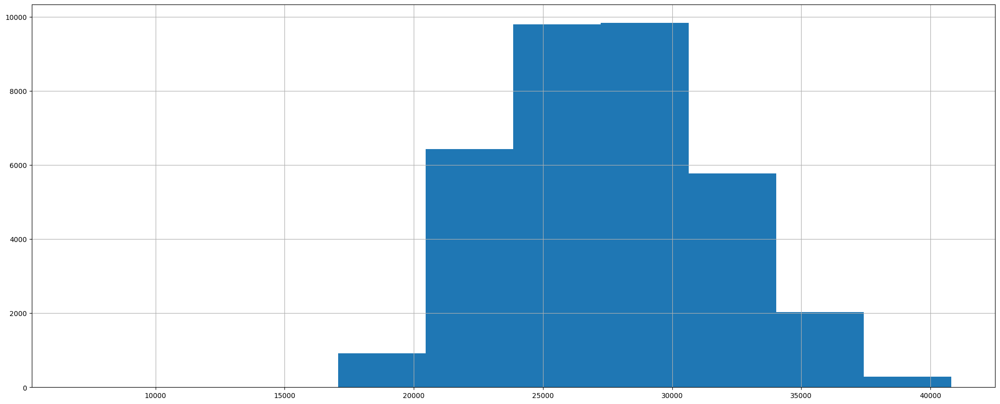

In [ ]:
df1['total generation'].hist()

In [ ]:
df1['total generation'].sum()

964546111.1373332

In [ ]:
df1['total load actual'].sum()

1006235407.3407543

In [ ]:
df1['total generation'].sum() - df1['total load actual'].sum()

-41689296.203421116

Negative value mean over the 4 year that there is shortage of electricity

In [195]:
df_joined_prediction = df_joined[['total load actual','total generation','generation fossil gas','generation fossil oil','generation hydro water reservoir','price actual','generation fossil hard coal','temp_C_max','generation other renewable','generation fossil brown coal/lignite','forecast solar day ahead','wind_speed','humidity','generation hydro run-of-river and poundage','rain_1h', 'generation nuclear', 'generation biomass']]

In [196]:
df_joined_prediction.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 34468 entries, 2015-01-01 00:00:00 to 2018-12-31 22:00:00
Data columns (total 17 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   total load actual                           34468 non-null  float64
 1   total generation                            34468 non-null  float64
 2   generation fossil gas                       34468 non-null  float64
 3   generation fossil oil                       34468 non-null  float64
 4   generation hydro water reservoir            34468 non-null  float64
 5   price actual                                34468 non-null  float64
 6   generation fossil hard coal                 34468 non-null  float64
 7   temp_C_max                                  34468 non-null  float64
 8   generation other renewable                  34468 non-null  float64
 9   generation fossil brown coal/lignite        3446

In [197]:
df_joined_prediction.describe()

,total load actual,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,wind_speed,humidity,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass
count,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000,34468.000000
mean,28703.639763,27515.312975,5614.009746,298.539689,2611.309736,57.865639,4244.930101,17.989742,85.647693,445.599038,1442.346843,2.457049,68.169692,975.161707,0.080978,6256.265219,384.159191
std,4575.739217,4103.904234,2201.770996,52.728033,1839.261715,14.235884,1968.493662,7.504520,14.121160,354.583554,1679.388982,1.386327,14.942722,400.676470,0.233266,840.506893,85.818288
min,18041.000000,6899.000000,0.000000,0.000000,0.000000,9.330000,0.000000,-3.900000,0.000000,-21.058574,0.000000,0.000000,22.600000,0.000000,0.000000,0.000000,0.000000
25%,24811.000000,24391.750000,4121.000000,263.000000,1082.000000,49.330000,2498.000000,12.200000,73.000000,0.000000,70.750000,1.400000,56.800000,639.000000,0.000000,5735.000000,333.000000
50%,28904.500000,27368.000000,4959.000000,300.000000,2167.500000,58.030000,4454.000000,17.320000,88.000000,505.000000,577.000000,2.200000,69.600000,911.000000,0.000000,6497.500000,367.000000
75%,32195.000000,30372.000000,6418.000000,330.000000,3767.000000,68.010000,5835.000000,23.600000,97.000000,752.000000,2641.000000,3.200000,80.000000,1253.000000,0.060000,7023.000000,437.000000
max,41015.000000,40810.000000,20034.000000,449.000000,9728.000000,116.800000,8359.000000,40.380000,119.000000,999.000000,5836.000000,20.000000,100.000000,2000.000000,5.000000,7117.000000,592.000000


In [162]:
df_joined_prediction.head()

,total load forecast,total generation,generation fossil gas,generation fossil oil,price day ahead,price actual,generation solar,temp_C,generation other renewable,generation biomass,...,total load actual,generation hydro water reservoir,generation fossil hard coal,temp_C_max,generation fossil brown coal/lignite,forecast solar day ahead,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass
Datetime,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,24934.0,26883.0,5196.0,158.0,48.10,64.92,50.0,-0.64,71.0,449.0,...,24382.0,1658.0,4755.0,-0.64,328.0,16.0,1009.0,0.0,7096.0,449.0
2015-01-01 01:00:00,23515.0,25868.0,4857.0,157.0,47.33,64.48,50.0,-1.08,73.0,448.0,...,22734.0,1371.0,4581.0,-1.08,323.0,8.0,973.0,0.0,7099.0,448.0
2015-01-01 02:00:00,22642.0,24371.0,4314.0,160.0,42.27,59.32,50.0,-3.90,75.0,438.0,...,21286.0,779.0,4131.0,-3.90,254.0,2.0,949.0,0.0,7098.0,438.0
2015-01-01 03:00:00,21785.0,23849.0,4130.0,156.0,38.41,56.04,42.0,-3.70,74.0,428.0,...,20264.0,720.0,3840.0,-3.70,187.0,9.0,953.0,0.0,7097.0,428.0
2015-01-01 04:00:00,21441.0,23487.0,4038.0,156.0,35.72,53.63,34.0,-1.14,74.0,410.0,...,19905.0,743.0,3590.0,-1.14,178.0,4.0,952.0,0.0,7098.0,410.0


In [198]:
df_joined_prediction.shape

(34468, 17)

In [199]:
df_daily_class = df_joined_prediction.resample("D").mean().dropna()

In [200]:
df_daily_class.shape

(1460, 17)

In [201]:
df_daily_class.head()

,total load actual,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,wind_speed,humidity,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass
Datetime,,,,,,,,,,,,,,,,,
2015-01-01,23966.958333,25233.375000,4187.791667,161.500000,2249.041667,62.090833,4099.458333,3.070833,73.500000,243.708333,1049.500000,1.583333,78.483333,1056.916667,0.000000,7097.416667,425.208333
2015-01-02,27188.541667,31055.916667,3566.166667,200.833333,3708.625000,69.443750,1258.125000,4.257292,61.958333,0.000000,1187.208333,1.347917,80.025000,1300.000000,0.000000,7105.416667,389.875000
2015-01-03,25097.750000,29188.708333,3451.791667,229.791667,3897.416667,65.223333,1375.958333,5.503403,65.833333,0.000000,1133.375000,1.352083,76.991667,1378.041667,0.000000,7094.958333,436.875000
2015-01-04,27104.916667,28816.500000,3526.125000,356.625000,3245.291667,58.912083,2315.291667,7.776181,58.041667,13.583333,2292.041667,1.057639,78.709028,1481.916667,0.069375,6956.541667,396.375000
2015-01-05,22506.578139,24746.839151,3794.631750,297.288874,2006.202167,74.598333,2350.176224,6.580833,74.460952,45.565406,1742.916667,1.184722,82.620833,1110.680817,0.010625,4564.699846,372.102663


In [202]:
df_daily_class.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1460 entries, 2015-01-01 to 2018-12-31
Data columns (total 17 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   total load actual                           1460 non-null   float64
 1   total generation                            1460 non-null   float64
 2   generation fossil gas                       1460 non-null   float64
 3   generation fossil oil                       1460 non-null   float64
 4   generation hydro water reservoir            1460 non-null   float64
 5   price actual                                1460 non-null   float64
 6   generation fossil hard coal                 1460 non-null   float64
 7   temp_C_max                                  1460 non-null   float64
 8   generation other renewable                  1460 non-null   float64
 9   generation fossil brown coal/lignite        1460 non-null   float64

Therfore we need to covert numerical dependent variable (total load actual) which is column 17 to categorical feature.

In [203]:
df_daily_class['total load actual'].max()

35339.791666666664

In [133]:
df_daily_class['total load actual'].min()

21493.625

In [134]:
df_daily_class['total load actual'].count()

1460

In [135]:
df_daily_class['total load actual'].sum()

41900405.3236513

In [204]:
df_daily_class['total load actual'].mean()

28698.907755925546

**Check**

 mean = 41900405/1460 = 28698.9

In [205]:
df_daily_class['total load actual']

Datetime
2015-01-01    23966.958333
2015-01-02    27188.541667
2015-01-03    25097.750000
2015-01-04    27104.916667
2015-01-05    22506.578139
                  ...     
2018-12-27    28551.708333
2018-12-28    28661.166667
2018-12-29    26603.958333
2018-12-30    25238.500000
2018-12-31    25966.173913
Name: total load actual, Length: 1460, dtype: float64

In [206]:
df_daily_class.loc[df_daily_class['total load actual']>=28700, 'total load actual']

Datetime
2015-01-07    31949.583333
2015-01-09    30403.250000
2015-01-12    31377.916667
2015-01-13    32135.750000
2015-01-14    32106.166667
                  ...     
2018-12-17    31875.208333
2018-12-18    32795.958333
2018-12-19    32160.875000
2018-12-20    31724.541667
2018-12-21    30542.666667
Name: total load actual, Length: 721, dtype: float64

In [207]:
df_daily_class.loc[df_daily_class['total load actual']<28700, 'total load actual']

Datetime
2015-01-01    23966.958333
2015-01-02    27188.541667
2015-01-03    25097.750000
2015-01-04    27104.916667
2015-01-05    22506.578139
                  ...     
2018-12-27    28551.708333
2018-12-28    28661.166667
2018-12-29    26603.958333
2018-12-30    25238.500000
2018-12-31    25966.173913
Name: total load actual, Length: 739, dtype: float64

#Therefore there is almost no imbalance in class since both class have almost similar number of records

In [208]:
df_daily_class.describe().T

,count,mean,std,min,25%,50%,75%,max
total load actual,1460.0,28698.907756,2746.445765,21493.625000,27140.526225,28664.187500,30813.135417,35339.791667
total generation,1460.0,27509.218976,2904.465060,20225.291667,25528.270833,27326.854167,29339.052083,36692.250000
generation fossil gas,1460.0,5623.318285,1858.509647,1831.666667,4284.437500,5099.375000,6498.291667,14943.958333
generation fossil oil,1460.0,298.335378,46.464303,147.333333,268.937500,300.062500,325.885417,417.791667
generation hydro water reservoir,1460.0,2606.306102,1420.797999,453.833333,1528.406250,2284.854167,3227.395833,7428.750000
price actual,1460.0,57.893889,12.077190,14.514583,50.846667,58.594792,66.575208,101.518571
generation fossil hard coal,1460.0,4255.088371,1869.420469,630.708333,2613.145833,4547.041667,5686.268382,7918.611111
temp_C_max,1460.0,17.963147,6.728837,3.070833,12.530618,17.190174,23.610615,32.115833
generation other renewable,1460.0,85.652293,13.366486,53.208333,73.166667,88.041667,96.875000,111.666667
generation fossil brown coal/lignite,1460.0,448.007836,338.442883,0.000000,23.375000,516.208333,754.334280,973.333333


**Choosing 28700 MW as threshold to create two classes since mean daily load is 28699 MW**

In [209]:
df_daily_class['high_load_level'] = df_daily_class['total load actual']>= 28700

In [210]:
df_daily_class.high_load_level.value_counts()

False    739
True     721
Name: high_load_level, dtype: int64

In [211]:
df_daily_class.head()

,total load actual,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,wind_speed,humidity,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass,high_load_level
Datetime,,,,,,,,,,,,,,,,,,
2015-01-01,23966.958333,25233.375000,4187.791667,161.500000,2249.041667,62.090833,4099.458333,3.070833,73.500000,243.708333,1049.500000,1.583333,78.483333,1056.916667,0.000000,7097.416667,425.208333,False
2015-01-02,27188.541667,31055.916667,3566.166667,200.833333,3708.625000,69.443750,1258.125000,4.257292,61.958333,0.000000,1187.208333,1.347917,80.025000,1300.000000,0.000000,7105.416667,389.875000,False
2015-01-03,25097.750000,29188.708333,3451.791667,229.791667,3897.416667,65.223333,1375.958333,5.503403,65.833333,0.000000,1133.375000,1.352083,76.991667,1378.041667,0.000000,7094.958333,436.875000,False
2015-01-04,27104.916667,28816.500000,3526.125000,356.625000,3245.291667,58.912083,2315.291667,7.776181,58.041667,13.583333,2292.041667,1.057639,78.709028,1481.916667,0.069375,6956.541667,396.375000,False
2015-01-05,22506.578139,24746.839151,3794.631750,297.288874,2006.202167,74.598333,2350.176224,6.580833,74.460952,45.565406,1742.916667,1.184722,82.620833,1110.680817,0.010625,4564.699846,372.102663,False


In [213]:
from pandas._libs.tslibs.vectorized import normalize_i8_timestamps

def normalize(x):
  y = (x-min(x))/(max(x)-min(x))
  return y

clmn = ['total load actual','total generation','generation fossil gas','generation fossil oil','generation hydro water reservoir','price actual','generation fossil hard coal','temp_C_max','generation other renewable','generation fossil brown coal/lignite','forecast solar day ahead','wind_speed','humidity','generation hydro run-of-river and poundage','rain_1h', 'generation nuclear', 'generation biomass']

normal_data = df_daily_class[clmn]

normal_df_daily_class = normal_data.apply(normalize)

normal_df_daily_class['high_load_level'] = df_daily_class['high_load_level']

display(normal_df_daily_class.head())
# Therefore, data is normalized since all values are between 0 and 1.

,total load actual,total generation,generation fossil gas,generation fossil oil,generation hydro water reservoir,price actual,generation fossil hard coal,temp_C_max,generation other renewable,generation fossil brown coal/lignite,forecast solar day ahead,wind_speed,humidity,generation hydro run-of-river and poundage,rain_1h,generation nuclear,generation biomass,high_load_level
Datetime,,,,,,,,,,,,,,,,,,
2015-01-01,0.178629,0.304129,0.179688,0.052380,0.257381,0.546828,0.475960,0.000000,0.347113,0.250385,0.308967,0.075142,0.705076,0.456501,0.000000,0.995522,0.616315,False
2015-01-02,0.411299,0.657719,0.132280,0.197812,0.466642,0.631341,0.086090,0.040849,0.149679,0.000000,0.358164,0.048718,0.734237,0.611133,0.000000,0.997891,0.525533,False
2015-01-03,0.260298,0.544327,0.123558,0.304884,0.493710,0.582832,0.102258,0.083752,0.215966,0.000000,0.338932,0.049185,0.676860,0.660777,0.000000,0.994794,0.646291,False
2015-01-04,0.405260,0.521724,0.129227,0.773841,0.400214,0.510293,0.231148,0.162002,0.082680,0.013955,0.752873,0.016135,0.709345,0.726855,0.037602,0.953813,0.542233,False
2015-01-05,0.073158,0.274583,0.149704,0.554450,0.222564,0.690586,0.235935,0.120847,0.363552,0.046814,0.556695,0.030400,0.783339,0.490702,0.005759,0.245661,0.479870,False


In [214]:
training_test_data = normal_df_daily_class.copy()

independent = training_test_data.loc[:,training_test_data.columns != 'high_load_level']

dependent = training_test_data['high_load_level']

#Split the dataset into training and test based on quality (Ratio 80:20)

from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(independent, dependent,test_size=0.20,random_state=4180)

print(x_train.shape)
print(x_test.shape)


(1168, 17)
(292, 17)


In [215]:
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.metrics._plot.confusion_matrix import confusion_matrix
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score, roc_curve, auc, accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score


logistic_regression = LogisticRegression(solver = 'liblinear', random_state=4180)

logistic_regression.fit(x_train,y_train.values.ravel())

log_prediction = logistic_regression.predict(x_test)

log_prediction_df = pd.DataFrame(log_prediction)

log_prediction_df.head()

,0
0,True
1,False
2,True
3,True
4,True


In [216]:
#Calculating accuracy
logistic_regression_accuracy=round(metrics.accuracy_score(y_test,log_prediction)*100,2)
logistic_regression_accuracy

# Therefore, accuracy of Logistic Regression model is almost 94.18%

93.49

In [217]:
print(y_train.shape)
print(y_test.shape)

(1168,)
(292,)


In [218]:
y_train.info()

<class 'pandas.core.series.Series'>
DatetimeIndex: 1168 entries, 2015-12-01 to 2017-09-20
Series name: high_load_level
Non-Null Count  Dtype
--------------  -----
1168 non-null   bool 
dtypes: bool(1)
memory usage: 10.3 KB


In [219]:
y_train.head()

Datetime
2015-12-01     True
2018-11-24    False
2018-10-18    False
2017-04-06    False
2015-10-23    False
Name: high_load_level, dtype: bool

In [220]:
y_test.head()

Datetime
2016-09-03     True
2017-04-30    False
2018-01-30     True
2016-06-10    False
2017-01-16     True
Name: high_load_level, dtype: bool

In [221]:
# Confusion Matrix for Logistic Regression
actual = y_test
predicted = log_prediction
Confusion_Matrix_Log_Reg = confusion_matrix(actual, predicted)
Confusion_Matrix_Log_Reg

array([[135,  11],
       [  8, 138]])

In [222]:
KNN = KNeighborsClassifier(n_neighbors=5)

KNN.fit(x_train, y_train.values.ravel())

KNN_prediction = KNN.predict(x_test)

KNN_prediction_df = pd.DataFrame(KNN_prediction)
KNN_prediction_df.head()

,0
0,True
1,False
2,True
3,True
4,True


In [223]:
#Calculating accuracy
KNN_accuracy=round(metrics.accuracy_score(y_test,KNN_prediction)*100,2)
KNN_accuracy

# Therefore, accuracy of KNN model is about 91.1% which is worse than logistic Regression model.

89.73

In [224]:
actual = y_test
predicted = KNN_prediction
Confusion_Matrix_KNN= confusion_matrix(actual, predicted)
Confusion_Matrix_KNN

array([[129,  17],
       [ 13, 133]])

In [229]:
#Logistic Regression Model
print("Logistic Regression Model")
LR_Accuracy = metrics.accuracy_score(y_test, log_prediction)
print("Logistic Regression Accuracy:", LR_Accuracy)
LR_Precision = metrics.precision_score(y_test, log_prediction, average='weighted', zero_division=0)
print("Logistic Regression Precision:", LR_Precision)
LR_Recall = metrics.recall_score(y_test, log_prediction, average='weighted', zero_division=0)
print("Logistic Regression Recall:", LR_Recall)

#KNN Model
print("KNN Model")
KNN_Accuracy = metrics.accuracy_score(y_test, KNN_prediction)
print("KNN Accuracy:", KNN_Accuracy)
KNN_Precision = metrics.precision_score(y_test, KNN_prediction, average='weighted', zero_division=0)
print("KNN Precision:", KNN_Precision)
KNN_Recall = metrics.recall_score(y_test, KNN_prediction, average='weighted', zero_division=0)
print("KNN Recall:", KNN_Recall)



Logistic Regression Model
Logistic Regression Accuracy: 0.934931506849315
Logistic Regression Precision: 0.9351152203501197
Logistic Regression Recall: 0.934931506849315
KNN Model
KNN Accuracy: 0.8972602739726028
KNN Precision: 0.8975586854460095
KNN Recall: 0.8972602739726028


Accuracy = (TP + TN) / (TP + FP + TN + FN) where TP = True positives, TN = True negatives, FP = False positives, and FN = False negatives. Accuracy measures the ratio of correct predictions made by the model to total predictions.
Accuracy of Logistic Regression model is almost 93.5% whihc is higher than KNN classification model Accuracy of 90%

Precision = TP / (TP + FP) Precision is the accuracy of predicting positive class.
Precision of Logistic Regression is almost 93.5% which is higher than KNN classifictaion Precision of almost 90%

Recall = TP / (TP + FN) Recall is the True positive rate which means it is the ratio or true postive to all postive.
Recall of Logistic Regression is almost 93.5% which is higher than KNN classifictaion Recall of almost 90%

All three performance measures are better for Logistic Regression model. Therefore, Logistic Regression perforem better than KNN classification for this dataset

In [226]:
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics


# Create a decision tree classifier
clf = DecisionTreeClassifier()

# Train the classifier on the training data
clf.fit(x_train, y_train)

# Make predictions on the testing data
DT_pred = clf.predict(x_test)

# Evaluate the accuracy of the classifier
accuracy = metrics.accuracy_score(y_test, DT_pred)
print("Accuracy:", accuracy)

Accuracy: 1.0


In [192]:
actual = y_test
predicted = DT_pred
Confusion_Matrix_DT= confusion_matrix(actual, predicted)
Confusion_Matrix_DT

array([[146,   0],
       [  0, 146]])

In [227]:
print("Decision Tree Classification Model Accuracy")
DT_Accuracy = metrics.accuracy_score(y_test, DT_pred)
print("Decision Tree Classification Accuracy:", DT_Accuracy)
DT_Precision = metrics.precision_score(y_test, DT_pred, average='weighted', zero_division=0)
print("Decision Tree Classification Precision:", DT_Precision)
DT_Recall = metrics.recall_score(y_test, DT_pred, average='weighted', zero_division=0)
print("Decision Tree Classification Recall:", DT_Recall)

Decision Tree Classification Model Accuracy
Decision Tree Classification Accuracy: 1.0
Decision Tree Classification Precision: 1.0
Decision Tree Classification Recall: 1.0


In [194]:
# there seem to be overfitting issue with Decision tree classifier because all three performance measures are 100%

The next steps is to refine these models and make them robust.